# World Data League 2023

## 🎯 Challenge

Avencas Marine Protected Area: Predict the future of the local ecosystem and its species

## Team: Random Fourest
## 👥 Authors
* Alina Carvalho
* João Almeida
* José Sousa
* Xavier Silva

## 💻 Development

### Dependencies

In [1]:
# ! pip install requests
# ! pip install odfpy
# ! pip install pyarrow
# ! pip install matplotlib
# ! pip install pandas
# ! pip install geopandas
# ! pip install interpret
# ! pip install scikit-learn

In [2]:
import os
import sys
from datetime import datetime
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
import numpy as np
import geopandas as gpd
import shapely
from interpret.glassbox import ExplainableBoostingClassifier, ExplainableBoostingRegressor
from interpret import show
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.metrics import mean_squared_error, mean_absolute_error

from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())

### Config

In [3]:
# Change this value to suit the location of the data on your machine:
data_path = "../../../data"

### Data Cleaning

For the sake of brevity we are not showing the preliminary data quality analysis that generated the cleaning processes applied.

In [4]:
# Read the original data from the Excel file:
workbook=pd.read_excel(os.path.join(data_path, "cascais_data/AMPA_Data_Sample.xlsx"), sheet_name=None, engine="openpyxl")

#### Sessil Data

Cleaning steps taken:
* Remove records with empty Date field
* Fix Supratidal/Middle Intertidal column values → set the values to be Supra or Medium
* Fix Substrate column values → normalize components that define the substrate, remove records with empty values.
* Remove invalid records due to Tide limitations → through Chthamalus sp. and Substrate column values
* Fix Hour column values
* Fix species column values → transform empty strings to zeros

In [5]:
# Set a the DataFrame of the spreadsheet from the workbook into its own variable:
df_sessil = workbook['Sessil (% Coverage)'].copy(deep=True)

In [6]:
# If date is blank/null/empty, exclude the record, we can't use it.
df_sessil = df_sessil.loc[~df_sessil["Date"].isna(), :]

In [7]:
# Fix "Supratidal/Middle Intertidal" column values to contain only "Supra" and "Medium" values
df_sessil["Supratidal/Middle Intertidal"] = ["Supra" if v[0] in ['s', 'S'] else v for v in df_sessil["Supratidal/Middle Intertidal"].str.strip().values]

In [8]:
# Normalize "Substrate" column values:
out = []
for value in df_sessil["Substrate"].astype("str").str.strip().values:
    substrate_classes = value.split('/')
    out.append("/".join(sorted([substrate.strip().capitalize() for substrate in substrate_classes])))

df_sessil["Substrate"] = out
df_sessil["Substrate"].astype("str").str.strip().value_counts().sort_index()

# According to the data owner, we can exclude records with empty "Substrate" values.
df_sessil = df_sessil.loc[df_sessil["Substrate"] != "Nan"]

In [9]:
# Drop rows with issues related with Tides:
df_sessil = df_sessil.loc[(df_sessil["Chthamalus sp."] != "NÃO FOI REALIZADO DEVIDO À MARÉ") & (df_sessil["Substrate"] != "High tide"), :]

In [10]:
# Fix "Hour" column:
values = []
for i, v in enumerate(df_sessil["Hour"].values):
    _v = str(v)
    _v = _v.replace(".", ":")
    values.append(_v)
values = [v.time() for v in pd.to_datetime(values)]
df_sessil["Hour"] = values

# Validation, should NOT print entries:
for i, v in enumerate(df_sessil["Hour"].values):
    if not isinstance(v, type(datetime.now().time())):
        print(i, type(v), v)

In [11]:
# Fix species columns:
sessil_species_columns = [
    'Chthamalus sp.',
    'Balanus perforatus',
    'Patella sp.',
    'Siphonaria algesirae',
    'Gibbula sp.',
    'Monodonta lineata',
    'Littorina neritoides',
    'Mytillus sp.',
    'Nassariidae (búzio)',
    'Chiton sp.',
    'Pollicipes pollicipes',
    'Actinia equina ',
    'Anemonia sulcata ',
    'Ophiothrix sp.',
    'Paracentrotus lividus',
    'Hymeniacidon sanguinea',
    'Aglaophenia pluma (hidrozoário branco ramificado)',
    'Alga branca ramificada',
    'Sabellaria alveolata  (tubos)',
    'Cerianthidae',
    'Anémona N.I.',
    'Actinia fragacea',
    'Gymnangium montagui',
    'Anémona branca com estrias (fam. Cerianthidae)',
    'Actinothoe sphyrodeta (anémona branca e laranja)',
    'Oncidiella celtica (lesma)',
    'Calliostoma sp. (burrié bicudo)',
    'Polysyncraton sp. (ascídias vermelhas)',
    'Didemnum sp. (ascídeas brancas)',
    'Burrié negro N.I.',
    'Búzio/burrié n.i.',
    'Watersipora subtorquata (Ascídea)',
    'Verrucaria maura ',
    'Lichina pygmaea (líquene folhoso)',
    'Coralina elongata',
    'Lithophillum incrustans',
    'Litophylum lichenoides',
    'Litophylum tortuosum',
    'Mesophylum lichenoides',
    'Gelidium sp. (tipo raquete)',
    'Asparagopsis armata (tufosa)',
    'Asparagopsis armata (adulta)',
    'Porphyra sp.',
    'Ceramium (forma taças)',
    'Mastocarpus sp. (alga preta só mediolitoral)',
    'Gigartina sp. (língua do diabo)',
    'Plocamium sp.',
    'Caulacanthus sp.',
    'Condracanthus',
    'Alga vermelha filamentosa',
    'Alga vermelha vesicular',
    'Alga vermelha laminada',
    'Alga vermelha carnuda',
    'Hildenbrandia sp. (incrustante vermelha)',
    'Chondria coerulescens (alga verde/azul filamentosa)',
    'Alga vermelha "encaracolada" (que parece ceramium pequeno) ',
    'Alga vermelha semelhante a Ulva rigida',
    'Porphira',
    'Osmundea pinnatifida',
    'Alga vermelha ramificada (Polysiphonia?)',
    'Ahnfeltiopsis devoniensis',
    'Stypocaulon scoparium (alga verde tufosa que parece pinheiro)',
    'Ulva rigida',
    'Cladophora sp. (limo)',
    'Limo N.I.',
    'Ulva intestinalis',
    'Ulva sp. ',
    'Codium sp. (alga verde carnuda)',
    'Alga verde carnuda ramificada',
    'Nemoderma sp.(alga tipo musgo)',
    'alga verde tufosa',
    'alga verde (tipo couve flor)',
    'Alga verde incrustante',
    'Alga verde n.i.',
    'Alga verde filamentosa',
    'Alga amarela tipo codium viscoso',
    'Cladostephus spongiosus (codium que parece que tem areia)',
    'Codium adhaerens (tipo nenúfar)',
    'Colpomenia sinuosa (alga bolhas)',
    'Fucus vesiculosus ',
    'Dictyota dichotoma (alga azul laminada)',
    'Dictyota castanha',
    'Alga castanha sp.',
    'Alga castanha laminada',
    'Alga castanha filamentosa',
    'Alga castanha incrustante',
    'Alga castanha carnuda',
    'Alga castanha tufosa',
    'Alga verde/azul - lavanda',
    'Sphacelaria rigidula (pompons castanhos)',
    'Cystoseira sp.',
    'Laminaria sp.'
]

# Get problem columns:
problem_cols = []

for col in sessil_species_columns:
    if not pd.api.types.is_numeric_dtype(df_sessil[col]):
        print("\"{}\" fails to be a number for all the rows".format(col))
        problem_cols.append(col)

# The columns with problems are due to having spaces in its' values, the data owner indicated that these should be considered zeros:
for col in problem_cols:
    for i, v in enumerate(df_sessil[col]):
        if not (isinstance(v, int) or isinstance(v, float)):
            df_sessil.loc[i, col] = 0

# Normalize column types to be floats:
for col in sessil_species_columns:
    df_sessil[col] = df_sessil[col].astype(float)

"Chthamalus sp." fails to be a number for all the rows
"Balanus perforatus" fails to be a number for all the rows
"Patella sp." fails to be a number for all the rows
"Gymnangium montagui" fails to be a number for all the rows
"Alga vermelha filamentosa" fails to be a number for all the rows
"Cystoseira sp." fails to be a number for all the rows


#### Mobil Data

Cleaning steps taken:
* Remove records with empty Date field
* Fix Date field → correct values that have invalid dates
* Fix Zone column → remove spaces
* Fix Tide column → change high values to be consistent with sessil data.
* Fix Supratidal/Middle Intertidal column values → set the values to be Supra or Medium
* Fix Substrate column values → normalize components that define the substrate, remove records with 0 values.
* Remove invalid records due to Tide limitations → through Caboz N.I. and Substrate column values
* Fix species column values → transform empty strings to zeros

In [12]:
# Set a the DataFrame of the spreadsheet from the workbook into its own variable:
# Yes, there is a space in the spreadsheet name
df_mobil = workbook[' Mobil (nº individuals)'].copy(deep=True)

In [13]:
# If date is blank/null/empty, exclude the record, we can't use it.
df_mobil = df_mobil.loc[~df_mobil["Date"].isna(), :]

In [14]:
# Fix "Date" column:
df_mobil["Date"] = [v if v not in ["23-04-01-2020", "14-10-2015"] else (datetime(2015, 10, 14) if v == "14-10-2015" else datetime(2020, 1, 23)) for v in df_mobil["Date"].values]

In [15]:
# Remove extra spaces from "Zone" values:
df_mobil["Zone"] = df_mobil["Zone"].str.strip()

In [16]:
# According to the data owner there shouldn't be very big values for the Tide column, as they represent depth of water in meters, the 0.6 to 0.9 range is what is expected, if there are much higher values they are in milimeters:
values = []
for v in df_mobil["Tide"].values:
    if isinstance(v, str):
        values.append(v.replace(",", ".").replace(";", "."))
    else:
        values.append(v)
df_mobil["Tide"] = values
df_mobil["Tide"] = df_mobil["Tide"].astype("float")

# Those big values came from a single day, looking at the sessil data the intended value should be 0.87.
# The wrong values appear as they were a cumulative sumation of the values in milimeters.
df_mobil.loc[df_mobil["Tide"] > 10, "Tide"] = 0.87

In [17]:
# Fix "Supratidal/Middle Intertidal" column values:
df_mobil["Supratidal/Middle Intertidal"] = ["Supra" if v[0] in ['s', 'S'] else v for v in df_mobil["Supratidal/Middle Intertidal"].str.strip().values]

In [18]:
# Normalize "Substrate" Column values:
out = []
for value in df_mobil["Substrate"].astype("str").str.strip().values:
    substrate_classes = value.split('/')
    out.append("/".join(sorted([substrate.strip().capitalize() for substrate in substrate_classes])))

df_mobil["Substrate"] = out
df_mobil["Substrate"].astype("str").str.strip().value_counts().sort_index()

# According to the data owner, Substrate being "0" is an error and should be removed:
df_mobil = df_mobil.loc[df_mobil["Substrate"] != '0', :]

In [19]:
# Drop rows with issues related with Tides:
df_mobil = df_mobil.loc[(df_mobil["Caboz N.I."] != 'NÃO FOI REALIZADO DEVIDO À MARÉ') & (df_mobil["Substrate"] != "High tide"), :]

In [20]:
# Fix species columns:
mobil_species_columns = [
    'Caboz N.I.',
    'Palaemon serratus',
    'Nasariidae (búzio)',
    'Diogenes pugilator',
    'Marthasterias glacialis',
    'Asterina gibbosa',
    'Eulalia viridis (poliqueta)',
    'Sabellaria alveolata',
    'Octopus vulgaris',
    'Sepia officinallis',
    'Alloteuthis subulata',
    'Loligo vulgaris',
    'Parablennius gattorugine',
    'Diplodus sp.',
    'Diplodus sargus',
    'Maja sp.',
    'Eriphia verrucosa',
    'Polybius henslowii',
    'Necora puber',
    'Aplysia punctata',
    'Podarcis carbonelli',
    'Acanthochitona fascicularis',
    'Sphaeroma sp. (bicho de conta)',
    'Chromodoris purpurea (nudibrânquio)',
    'Lipophrys pholis (juvenil/recruta)',
    'Pomatoschistus pictus (caboz-de-areia)',
    'Peixe juvenil N.I.',
    'Juvenis de lagosta/lavagante',
    'caranguejo N.I.',
    'Xantho sp.',
    'Carcinus maenas',
    'Atherina presbyter',
    'Diplodus vulgaris',
    'Syngnathus (Marinha)',
    'Lepadogaster lepadogaster',
    'Poliqueta n.i.',
    'Nereis sp.',
    'Ofiurídeo n.i.',
    'Chiton sp. ',
    'Acanthochitona fascicularis (quíton com pêlos)',
    'Leptochiton cancellatus',
    'Anémona n.i.',
    'Pagurus sp. (caranguejo eremita)',
    'Pachygrapsus marmoratus (caranguejo pequeno verde)',
    'Porcellana sp. (caranguejo pinças largas)',
    'Palaemon sp.',
    'Gobius sp.',
    'Parablennius sp. (marachomba)',
    'Parablennius pilicornis',
    'Nudibranquio N.I.',
    'Callionymus lira (peixe-pau lira)',
    'Oncidiella celtica',
    'Doriopsilla areolata (nudibrânquio)',
    'Scorpaena sp. (Rascasso)',
    'Lipophrys pholis (ad.)',
    'Diplodus cervinus',
    'Gobiusculus flavescens'
]

# Get problem columns:
problem_cols = []

for col in mobil_species_columns:
    if not pd.api.types.is_numeric_dtype(df_mobil[col]):
        print("\"{}\" fails to be a number for all the rows".format(col))
        problem_cols.append(col)
        
# The columns with problems are due to having spaces in its' values, the data owner indicated that these should be considered zeros:
for col in problem_cols:
    for i, v in enumerate(df_mobil[col]):
        if not (isinstance(v, int) or isinstance(v, float)):
            df_mobil.loc[i, col] = 0

# Normalize column types to be floats:
for col in mobil_species_columns:
    df_mobil[col] = df_mobil[col].astype(float)

"Caboz N.I." fails to be a number for all the rows
"Palaemon serratus" fails to be a number for all the rows
"Nasariidae (búzio)" fails to be a number for all the rows
"Diogenes pugilator" fails to be a number for all the rows
"Eriphia verrucosa" fails to be a number for all the rows


#### Species Lists

Aside from taking it as a reference we didn't use these lists directly.

We leave the extraction code here for two reasons:
* For completeness in the Excel file data parse
* To point out that the lists don't match the actual columns in the sampling

In [21]:
df_lists = workbook['Invasive_conservat species list'].copy(deep=True)

In [22]:
df_sessil_list = df_lists.loc[:, ['Unnamed: 1', 'Unnamed: 2', 'Unnamed: 3']]

df_sessil_list.columns = df_sessil_list.loc[0].values

df_sessil_list = df_sessil_list.loc[2:,:]

with pd.option_context("display.min_rows", None, "display.max_rows", None):
    display(df_sessil_list)

,Sessil species,Invasive (Yes/No),Conservation Status (IUCN)
2,Chthamalus sp.,No,no conservation status for this taxon
3,Balanus perforatus,No,no conservation status for this taxon
4,Patella sp.,No,no conservation status for this taxon
5,Siphonaria algesirae,No,no conservation status for this taxon
6,Gibbula sp.,No,no conservation status for this taxon
7,Monodonta lineata,No,no conservation status for this taxon
8,Littorina neritoides,No,no conservation status for this taxon
9,Mytillus sp.,No,no conservation status for this taxon
10,Nassariidae,No,no conservation status for this taxon
11,Chiton sp.,No,no conservation status for this taxon


In [23]:
df_mobil_list = df_lists.loc[:, ['Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8']]

df_mobil_list.columns = df_mobil_list.loc[0].values

df_mobil_list = df_mobil_list.loc[2:,:]

df_mobil_list = df_mobil_list.loc[~df_mobil_list["Mobil species"].isna()]

with pd.option_context("display.min_rows", None, "display.max_rows", None):
    display(df_mobil_list)

,Mobil species,Invasive (Yes/No),Conservation Status (IUCN)
2,Rock Fish Non Identified,No,no conservation status for this taxon
3,Palaemon serratus,No,no conservation status for this taxon
4,Nasariidae,No,no conservation status for this taxon
5,Diogenes pugilator,No,no conservation status for this taxon
6,Marthasterias glacialis,No,no conservation status for this taxon
7,Asterina gibbosa,No,no conservation status for this taxon
8,Eulalia viridis,No,no conservation status for this taxon
9,Octopus vulgaris,No,least concern (LC)
10,Parablennius gattorugine,No,least concern (LC)
11,Diplodus sp.,No,commercially threatened (CT)*


### Gather Weather data

We gather weather data from the [Open-Meteo](https://open-meteo.com) historical API service (free access for non-commercial use)

We picked the following metrics:
| Metric                      | Weather Models        | Description                                  | 
| --------------------------- | --------------------- | -------------------------------------------- |
| temperature_2m              | ERA5+ERA5-Land, CERRA | Temperature at 2m in °C                      |
| pressure_msl                | ERA5+ERA5-Land, CERRA | Sea level pressure in hPa                    |
| rain                        | ERA5+ERA5-Land, CERRA | Rain (excluding snow) in mm                  |
| weathercode                 | ERA5+ERA5-Land, CERRA | Weather code as wmo code                     |
| cloudcover                  | ERA5+ERA5-Land, CERRA | Cloud coverage (Total) in %                  |
| shortwave_radiation         | ERA5+ERA5-Land, CERRA | Shortwave solar radiation in W/m²            |
| direct_radiation            | ERA5+ERA5-Land, CERRA | Direct solar radiation in W/m²               |
| diffuse_radiation           | ERA5+ERA5-Land, CERRA | Diffuse solar radiation in W/m²              |
| direct_normal_irradiance    | ERA5+ERA5-Land, CERRA | Direct normal irradiance (DNI) in W/m²       |
| windspeed_10m               | ERA5+ERA5-Land, CERRA | Wind Speed at 10m in km/h                    |
| winddirection_10m           | ERA5+ERA5-Land, CERRA | Wind Direction at 10m in °                   |
| windgusts_10m               | ERA5+ERA5-Land, CERRA | Wind Gusts at 10m in km/h                    |
| soil_temperature_0_to_7cm   | ERA5+ERA5-Land        | Soil Temperature (0-7cm) in °C               |
| soil_moisture_0_to_7cm      | ERA5+ERA5-Land        | Soil Moisture (0-7cm) in m³/m³               |

#### Configuration

In [24]:
# Weather ingestion details

weather_api_url = "https://archive-api.open-meteo.com/v1/archive"

# Metrics to gather
weather_hourly_metrics = [
    "temperature_2m",            # Temperature at 2m in °C
    "pressure_msl",              # Sea level pressure in hPa
    "rain",                      # Rain (excluding snow) in mm
    "weathercode",               # Weather code as wmo code
    "cloudcover",                # Cloud coverage (Total) in %
    "shortwave_radiation",       # Shortwave solar radiation in W/m²
    "direct_radiation",          # Direct solar radiation in W/m²
    "diffuse_radiation",         # Diffuse solar radiation in W/m²
    "direct_normal_irradiance",  # Direct normal irradiance (DNI) in W/m²
    "windspeed_10m",             # Wind Speed at 10m in km/h
    "winddirection_10m",         # Wind Direction at 10m in °
    "windgusts_10m",             # Wind Gusts at 10m in km/h
    "soil_temperature_0_to_7cm", # Soil Temperature (0-7cm) in °C  - Not present in CERRA model
    "soil_moisture_0_to_7cm"     # Soil Moisture (0-7cm) in m³/m³  - Not present in CERRA model
]

# Weather interpolation/inference models 
weather_models = [
    "best_match",  # ERA5 (25Km) and ERA5-Land (10Km) combination
    "cerra"        # CERRA (5Km), only applicable if in European geography
]

start_date = datetime(2011, 11, 1)
end_date = datetime(2020, 12, 1)

latitude=38.6883
longitude=-9.3609

#### Fetch the hourly data month by month

In [25]:
weather_data_path = os.path.join(data_path, "avencas_weather_data")

os.makedirs(weather_data_path, exist_ok=True)

def next_month(d):
    return datetime(d.year if d.month < 12 else d.year + 1, d.month + 1 if d.month < 12 else 1, d.day)

metrics_request = ",".join(weather_hourly_metrics)
models_request = ",".join(weather_models)

r = 0
downloaded = 0
curr_date = start_date
while curr_date < end_date:
    next_date = next_month(curr_date)
    
    sys.stdout.write("\rGathering weather information from {} to {} (request nº: {})                ".format(curr_date.strftime('%Y-%m-%d'), next_date.strftime('%Y-%m-%d'), r))
    
    destination_path = os.path.join(
        weather_data_path,
        "{}.parquet".format(curr_date.strftime('%Y-%m'))
    )
    
    if os.path.exists(destination_path):
        # sys.stdout.write("\nWarning: Skipping request from {} to {}, data already processed\n".format(curr_date.strftime('%Y-%m-%d'), next_date.strftime('%Y-%m-%d')))
        pass
    else:
        response = requests.get(
            weather_api_url,
            params={
                "latitude": latitude,
                "longitude": longitude,
                "start_date": curr_date.strftime('%Y-%m-%d'),
                "end_date": (next_date - timedelta(days=1)).strftime('%Y-%m-%d'),
                "hourly": metrics_request,
                "models": models_request
            }
        )

        if response.status_code != 200:
            sys.stdout.write("\nWarning: Request failed from {} to {}\n".format(curr_date.strftime('%Y-%m-%d'), next_date.strftime('%Y-%m-%d')))
        else:
            # Update statistics and save data to disk
            r += 1
            downloaded += len(response.content)
            weather = json.loads(response.content)
            pd.DataFrame(weather["hourly"]).to_parquet(destination_path)
            # To avoid hammering the open-meteo server with requests...
            time.sleep(0.25)
        
    curr_date = next_date

sys.stdout.write("\rDone {} to {} (total requests: {}, {} bytes)                                       \n".format(start_date, end_date, r, downloaded));

Done 2011-11-01 00:00:00 to 2020-12-01 00:00:00 (total requests: 0, 0 bytes)                                       


#### Consolidate the data in a single DataFrame

In [26]:
all_weather_files = [os.path.join(root, file) for root, dirs, files in os.walk(weather_data_path) if len(files) > 0 for file in sorted(files) if not file.startswith(".")]

all_weather_data = pd.concat([pd.read_parquet(f) for f in all_weather_files])
all_weather_data["time"] = pd.to_datetime(all_weather_data["time"])
all_weather_data

,time,temperature_2m_best_match,pressure_msl_best_match,rain_best_match,weathercode_best_match,cloudcover_best_match,shortwave_radiation_best_match,direct_radiation_best_match,diffuse_radiation_best_match,direct_normal_irradiance_best_match,...,rain_cerra,weathercode_cerra,cloudcover_cerra,shortwave_radiation_cerra,direct_radiation_cerra,diffuse_radiation_cerra,direct_normal_irradiance_cerra,windspeed_10m_cerra,winddirection_10m_cerra,windgusts_10m_cerra
0,2011-11-01 00:00:00,17.4,1016.3,0.2,51,100,0.0,0.0,0.0,0.0,...,1.6,61,100,0.0,0.0,0.0,0.0,12.6,0,20.5
1,2011-11-01 01:00:00,17.2,1016.0,0.0,3,88,0.0,0.0,0.0,0.0,...,0.8,53,100,0.0,0.0,0.0,0.0,11.9,0,21.2
2,2011-11-01 02:00:00,17.1,1015.9,0.0,3,100,0.0,0.0,0.0,0.0,...,0.2,51,94,0.0,0.0,0.0,0.0,9.0,18,18.4
3,2011-11-01 03:00:00,16.8,1015.8,0.0,3,84,0.0,0.0,0.0,0.0,...,0.0,3,94,0.0,0.0,0.0,0.0,9.0,14,14.4
4,2011-11-01 04:00:00,16.5,1015.4,0.0,2,68,0.0,0.0,0.0,0.0,...,0.0,3,95,0.0,0.0,0.0,0.0,13.7,6,20.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,2020-11-30 19:00:00,16.3,1019.5,0.2,51,64,0.0,0.0,0.0,0.0,...,0.1,51,100,0.0,0.0,0.0,0.0,21.6,72,31.7
716,2020-11-30 20:00:00,16.0,1020.0,0.5,53,68,0.0,0.0,0.0,0.0,...,0.2,51,66,0.0,0.0,0.0,0.0,21.6,80,32.8
717,2020-11-30 21:00:00,15.7,1020.2,0.3,51,62,0.0,0.0,0.0,0.0,...,0.0,1,49,0.0,0.0,0.0,0.0,21.2,78,32.8
718,2020-11-30 22:00:00,15.4,1020.7,0.0,1,34,0.0,0.0,0.0,0.0,...,0.0,2,62,0.0,0.0,0.0,0.0,18.4,72,27.7


### EDA

#### Metadata

Sessil Species listed in data dictionary:

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th>Alias / Common name</th>
      <th>Provided Name</th>
      <th>Group</th>
      <th>Kingdom</th>
      <th>Class/Clade/Subclass/Division</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td></td>
      <td>Chthamalus sp.</td>
      <td>Barnacle</td>
      <td>Animalia</td>
      <td>Thecostraca</td>
    </tr>
    <tr>
      <td></td>
      <td>Balanus perforatus</td>
      <td>Barnacle</td>
      <td>Animalia</td>
      <td>Thecostraca</td>
    </tr>
    <tr>
      <td></td>
      <td>Patella sp.</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Siphonaria algesirae</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Gibbula sp.</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Monodonta lineata</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Littorina neritoides</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td>Mytilus</td>
      <td>Mytillus sp.</td>
      <td>Mussels</td>
      <td>Animalia</td>
      <td>Bivalvia</td>
    </tr>
    <tr>
      <td></td>
      <td>Nassariidae</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Chiton sp.</td>
      <td>Chitons</td>
      <td>Animalia</td>
      <td>Polyplacophora</td>
    </tr>
    <tr>
      <td></td>
      <td>Pollicipes pollicipes</td>
      <td>Goose Barnacle</td>
      <td>Animalia</td>
      <td>Thecostraca</td>
    </tr>
    <tr>
      <td>Beadlet anemone</td>
      <td>Actinia equina</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Hexacorallia</td>
    </tr>
    <tr>
      <td></td>
      <td>Anemonia sulcata</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Hexacorallia</td>
    </tr>
    <tr>
      <td></td>
      <td>Ophiothrix sp.</td>
      <td>Brittle stars</td>
      <td>Animalia</td>
      <td>Ophiuroidea</td>
    </tr>
    <tr>
      <td>purple sea urchin</td>
      <td>Paracentrotus lividus</td>
      <td>Sea Urchin</td>
      <td>Animalia</td>
      <td>Echinoidea</td>
    </tr>
    <tr>
      <td></td>
      <td>Hymeniacidon sanguinea</td>
      <td>Sea Sponge</td>
      <td>Animalia</td>
      <td>Demospongiae</td>
    </tr>
    <tr>
      <td>toothed feather hydroid</td>
      <td>Aglaophenia pluma</td>
      <td>Hydroid</td>
      <td>Animalia</td>
      <td>Hydrozoa</td>
    </tr>
    <tr>
      <td>honeycomb worm</td>
      <td>Sabellaria alveolata</td>
      <td>Polychaete</td>
      <td>Animalia</td>
      <td>Pleistoannelida</td>
    </tr>
    <tr>
      <td></td>
      <td>Cerianthidae</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Ceriantharia</td>
    </tr>
    <tr>
      <td>Anemone Not Identified</td>
      <td>Anémona N.I.</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Anthozoa/Hexacorallia?</td>
    </tr>
    <tr>
      <td>Strawberry anemone</td>
      <td>Actinia fragacea</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Hexacorallia</td>
    </tr>
    <tr>
      <td>Sandalled anemone</td>
      <td>Actinothoe sphyrodeta</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Hexacorallia</td>
    </tr>
    <tr>
      <td>Onchidella celtica</td>
      <td>Oncidiella celtica</td>
      <td>Sea Slug</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Calliostoma sp.</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
    </tr>
    <tr>
      <td></td>
      <td>Indentified Black snail</td>
      <td>Sea Snails?</td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Verrucaria maura</td>
      <td>Lichenized Fungi</td>
      <td>Fungi</td>
      <td>Eurotiomycetes</td>
    </tr>
    <tr>
      <td></td>
      <td>Lichina pygmaea</td>
      <td>Lichens</td>
      <td>Fungi</td>
      <td>Lichinomycetes</td>
    </tr>
    <tr>
      <td></td>
      <td>Coralina elongata</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Lithophyllum incrustans</td>
      <td>Lithophillum incrustans</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Lithophyllum byssoides</td>
      <td>Litophylum lichenoides</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Litophylum tortuosum</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Mesophyllum lichenoides</td>
      <td>Mesophylum lichenoides</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Gelidium sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Asparagopsis armata</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Porphyra sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Ceramium sp</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Mastocarpus sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Gigartinales/Gigartinaceae?</td>
      <td>Gigartina sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Plocamium sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Caulacanthus sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Chondracanthus</td>
      <td>Condracanthus sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Hildenbrandia sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Ahnfeltiopsis devoniensis</td>
      <td>Ahnfeltiopsis devoniensis</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Porphyra</td>
      <td>Porphira sp.</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Osmundea pinnatifida</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Chondria coerulescens</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Red Algae Non Identified</td>
      <td>Red Algea</td>
      <td>Plantae</td>
      <td>Rhodophyta</td>
    </tr>
    <tr>
      <td>Halopteris scoparia</td>
      <td>Stypocaulon scoparium</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Ulva rigida</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Cladophora sp.</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td>?</td>
      <td>Lime Non Identify</td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Ulva intestinalis</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Ulva sp.</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Codium sp.</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Nemoderma sp.</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Cladostephus spongiosus</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Codium adhaerens</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Green Algae Non Identified</td>
      <td>Green Algea</td>
      <td>Plantae</td>
      <td>Chlorophyta</td>
    </tr>
    <tr>
      <td></td>
      <td>Colpomenia sinuosa</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Fucus vesiculosus</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Dictyota dichotoma</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Dictyota sp.</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Sphacelaria rigidula</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Cystoseira sp.</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Laminaria sp.</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
    <tr>
      <td></td>
      <td>Brown Algae Non Identified</td>
      <td>Brown Algea</td>
      <td>Chromista</td>
      <td>Phaeophyceae</td>
    </tr>
  </tbody>
</table>

Mobil Species in data dictionary:

<table border="1">
  <thead>
    <tr style="text-align: left;">
      <th>Alias / Common Name</th>
      <th>Provided Name</th>
      <th>Group</th>
      <th>Kingdom</th>
      <th>Class/Clade/Subclass/Division</th>
      <th>Lifespan</th>
      <th>Predators</th>
      <th>Preys</th>
      <th>Notes</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td></td>
      <td>Rock Fish Non Identified</td>
      <td>Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Palaemon serratus</td>
      <td>Shrimps</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td>3~5 years</td>
      <td>Fish (ex: Mullidae, Moronidae, Sparidae and Batrachoididae), Bopyrus squillarum (parasite)</td>
      <td></td>
      <td>Population is highly seasonal, with a pronounced peak in the autumn.</td>
    </tr>
    <tr>
      <td>Nassariidae</td>
      <td>Nasariidae</td>
      <td>Sea Snails</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td>Scavanger</td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Diogenes pugilator</td>
      <td>Hermit Crab</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Marthasterias glacialis</td>
      <td>Starfish</td>
      <td>Animalia</td>
      <td>Asteroidea</td>
      <td></td>
      <td></td>
      <td>Bivalve molluscs, other invertebrates</td>
      <td>The reproductive biology of this starfish has been little studied but off the coast of Ireland, individuals gather together in very shallow water in July and August.A few days later, on a warm afternoon, they have been observed to arch their bodies and release spawn into the sea.A rise in the water temperature seems to have triggered the spawning.</td>
    </tr>
    <tr>
      <td></td>
      <td>Asterina gibbosa</td>
      <td>Starfish</td>
      <td>Animalia</td>
      <td>Asteroidea</td>
      <td></td>
      <td></td>
      <td>Scavanger</td>
      <td>Asterina gibbosa is mainly nocturnal, spending the day underneath boulders, overhangs or in caves, or hidden away under algae in rock pools.</td>
    </tr>
    <tr>
      <td></td>
      <td>Eulalia viridis</td>
      <td>Worms</td>
      <td>Animalia</td>
      <td>Polychaeta</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Common octopus</td>
      <td>Octopus vulgaris</td>
      <td>Mollusc</td>
      <td>Animalia</td>
      <td>Cephalopoda</td>
      <td></td>
      <td></td>
      <td>Crabs, crayfish, and bivalve molluscs (such as cockles) are preferred, although the octopus eats almost anything it can catch.</td>
      <td>They prefer the floor of relatively shallow, rocky, coastal waters, often no deeper than 200 m (660 feet).Although they prefer around 36 grams per liter (0.0013 lb/cu in), salinity throughout their global habitat is found to be between roughly 30 and 45 grams per liter (0.0011 and 0.0016 lb/cu in).They are exposed to a wide variety of temperatures in their environments, but their preferred temperature ranges from about 15 to 16 °C (59 to 61 °F).[15] In especially warm seasons, the octopus can often be found deeper than usual to escape the warmer layers of water.Spawning of O. vulgaris in this area extends from December to September with a unique peak in spring months.</td>
    </tr>
    <tr>
      <td>Tompot blenny</td>
      <td>Parablennius gattorugine</td>
      <td>Blennies Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td>capillariid Nematode Pseudocapillaria bainae (parasite)</td>
      <td>Sea anemones and on other invertebrates such as prawns and other crustaceans.</td>
      <td>They are crepuscular, being active mainly at dawn and at dusk.</td>
    </tr>
    <tr>
      <td></td>
      <td>Diplodus sp.</td>
      <td>Seabream Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Sargo</td>
      <td>Diplodus sargus</td>
      <td>Seabream Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>small crustaceans, mollusks and some seaweed and coral</td>
      <td>They inhabit the surf/breaker zone, but they may be found down to 50 m.</td>
    </tr>
    <tr>
      <td></td>
      <td>Maja sp.</td>
      <td>Majid Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Warty/Yellow Crab</td>
      <td>Eriphia verrucosa</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td>bivalves, gastropods and hermit crabs</td>
      <td>The species is threatened by eutrophication and pollution.In the springtime, E. verrucosa migrates to shallow water, less than 1 metre (3 ft 3 in) deep, and reproduction begins in May or June; the species is highly fecund.</td>
    </tr>
    <tr>
      <td></td>
      <td>Polybius henslowii</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td>Squid, fish, and other crustaceans, including specimens of the same species.When they swim inshore, along the coastal upwelling areas of Galicia (NW Spain), they rely more on benthic prey, such as polychaetes and detritus [6] and are influenced by terrestrial organic matter coming from the rivers.</td>
      <td></td>
    </tr>
    <tr>
      <td>Velvet Crab</td>
      <td>Necora puber</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Aplysia punctata</td>
      <td>Sea Slugs</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td>Algal seaweed beds</td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Acanthochitona fascicularis</td>
      <td>Chitons</td>
      <td>Animalia</td>
      <td>Polyplacophora</td>
      <td></td>
      <td></td>
      <td>Encrusting or filamentous algae and possibly bryozoans</td>
      <td></td>
    </tr>
    <tr>
      <td>Sand smelt</td>
      <td>Atherina presbyter</td>
      <td>Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>Small crustaceans and fish larvae</td>
      <td>Seasonal Migration in the Atlantic.Reproduction takes place in the spring and summer.</td>
    </tr>
    <tr>
      <td></td>
      <td>Sphaeroma sp.</td>
      <td>Isopods</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Felimida purpurea</td>
      <td>Chromodoris purpurea</td>
      <td>Sea Slugs</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Shanny</td>
      <td>Lipophrys pholis</td>
      <td>Blennies Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>small benthic invertebrates, especially snails, barnacles and amphipods, as well as some algae. Less important in its diet are crabs, polychaetes, isopods, copepods, limpets, mussels and other small molluscs.</td>
      <td>It is largely diurnal at high tide and it can breathe air when exposed by the ebbing tide.Intertidal species which displays homing behavior and which occurs along rocky coasts in shallow waters.Spawning occurs in the warmer months of April to August.The larvae are young can be common on shorelines in the autumn.</td>
    </tr>
    <tr>
      <td>Painted goby</td>
      <td>Pomatoschistus pictus</td>
      <td>Goby Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>amphipods and copepods.</td>
      <td>It lives at depths from 1 to 55 metres (3.3 to 180.4 ft), preferring a gravelly or sandy environment. Its young may sometimes be found in tide pools.</td>
    </tr>
    <tr>
      <td></td>
      <td>Juvenil fish Non Identified</td>
      <td>Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Crab Non Identified</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Xantho sp.</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>green shore crab</td>
      <td>Carcinus maenas</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td>bivalve molluscs (such as clams – up to 40 1⁄2 inch (13 mm) clams per day, oysters, and mussels), polychaetes, and small crustaceans – including other crabs up to their own size.</td>
      <td>can tolerate a wide range of salinities (from 4 to 52 ‰), and survive in temperatures of 0 to 30 °C (32 to 86 °F).They are primarily diurnal, although activity also depends on the tide, and crabs can be active at any time of day.</td>
    </tr>
    <tr>
      <td></td>
      <td>Diplodus vulgaris</td>
      <td>Seabream Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td>In the western Mediterranean, it reproduces in October and November and in the eastern Mediterranean in December and January.</td>
    </tr>
    <tr>
      <td></td>
      <td>Syngnathus sp.</td>
      <td>Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Shore clingfish</td>
      <td>Lepadogaster lepadogaster</td>
      <td>Clingfish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>mostly detritus material, meaning that it lives off the dead organic matter of its environment.</td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Worm Non Identified</td>
      <td>Worms</td>
      <td>Animalia</td>
      <td>Polychaeta</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Ofiurídeo n.i.</td>
      <td>Starfish</td>
      <td>Animalia</td>
      <td>Asteroidea</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Chiton sp.</td>
      <td>Chitons</td>
      <td>Animalia</td>
      <td>Polyplacophora</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Leptochiton cancellatus</td>
      <td>Chitons</td>
      <td>Animalia</td>
      <td>Polyplacophora</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Anémona n.i.</td>
      <td>Sea Anemone</td>
      <td>Animalia</td>
      <td>Hexacorallia</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Pagurus sp.</td>
      <td>Hermit Crab</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td>omnivorous, but mostly prey on small animals and scavenge carrion.</td>
      <td></td>
    </tr>
    <tr>
      <td>Marbled Rock Crab</td>
      <td>Pachygrapsus marmoratus</td>
      <td>Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td>include the musky octopus, Eledone moschata.</td>
      <td>omnivore, but not an opportunist;similar proportions of algae and animals are consumed however abundant they are in the habitat.The favoured animals are mussels, limpets and its own species.When attacking the limpet Patella depressa, is usually unsuccessful.On more sheltered shores, P. grapsus eats fewer mussels, but compensates with a greater consumption of barnacles.</td>
      <td></td>
    </tr>
    <tr>
      <td>Porcelain Crab</td>
      <td>Porcellana sp.</td>
      <td>Porcelain Crabs</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td>Superficially resemble true crabs.</td>
    </tr>
    <tr>
      <td></td>
      <td>Palaemon sp.</td>
      <td>Shrimps</td>
      <td>Animalia</td>
      <td>Malacostraca</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Gobius sp.</td>
      <td>Goby Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Parablennius sp.</td>
      <td>Blennies Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Parablennius pilicornis</td>
      <td>Blennies Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Nudibranquio N.I.</td>
      <td>Sea Slugs</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>Common dragonet, Callionymus lyra</td>
      <td>Callionymus lira</td>
      <td>Dragonet Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td>Max ~7 years</td>
      <td>Atlantic cod and pouting</td>
      <td>mostly on small invertebrates, such as worms and crustaceans</td>
      <td>It is most frequently found between 5 metres (16 ft) and 50 metres (160 ft). It is found in temperate waters with a water temperature of 16–20 °C (61–68 °F). It spends most of its time on the seabed partially buried in sand or shell gravel.</td>
    </tr>
    <tr>
      <td>Onchidella</td>
      <td>Oncidiella celtica</td>
      <td>Sea Slugs</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td></td>
      <td>This air-breathing sea slug lives in the intertidal zone on rocky shorelines. It is exposed on rocky shores at low tides and retreats to crevices when the tide rises.</td>
    </tr>
    <tr>
      <td></td>
      <td>Doriopsilla areolata</td>
      <td>Sea Slugs</td>
      <td>Animalia</td>
      <td>Gastropoda</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Scorpaena sp.</td>
      <td>Scorpion Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td></td>
      <td>Diplodus cervinus</td>
      <td>Seabream Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td></td>
      <td>Youth, it prefers shallow and quiet living areas like rocks, piers and grass beds. Adult, it usually lives rocky slopes and wrecks.</td>
    </tr>
    <tr>
      <td>Two-spotted goby</td>
      <td>Gobiusculus flavescens</td>
      <td>Goby Fish</td>
      <td>Animalia</td>
      <td>Actinopterygii</td>
      <td></td>
      <td></td>
      <td>zooplankton such as crustacean larvae</td>
      <td>in shoals among seagrasses and seaweeds.Breeding takes place in the summer.The juvenile fish move into deeper water to spend the winter. The adults usually die after reproducing once.</td>
    </tr>
  </tbody>
</table>

#### Geography

"zona de interesse biofísico das Avencas" (ZIBA) was defined in 1998 and was replaced by "Área marinha protegida das Avencas" (AMPA) in 2016:
* [Resolução do Conselho de Ministros n.º 64/2016, de 19 de outubro, Artigo 8.º - Diário da República n.º 201/2016, Série I de 2016-10-19, páginas 3770 - 3772](https://dre.pt/dre/detalhe/resolucao-conselho-ministros/64-2016-75554998), replaces [Resolução do Conselho de Ministros n.º 123/98, de 19 de outubro - Diário da República n.º 241/1998, Série I-B de 1998-10-19, páginas 5389 - 5406](https://dre.pt/dre/detalhe/resolucao-conselho-ministros/123-1998-240050)
* [Edital n.º 5/2021, de 5 de janeiro - CAPÍTULO VII - Diário da República n.º 2/2021, Série II de 2021-01-05, páginas 21 - 59](https://dre.pt/dre/detalhe/edital/5-2021-152944754)

The coordinates given are in WGS84 with true north azimuth:

* 38°41’35” N; 9°22’03” W → 38.693056, -9.3675
* 38°41’10” N; 9°21’15” W → 38.686111, -9.354167
* 38°41’23” N; 9°22’11” W → 38.689722, -9.369722
* 38°40’57” N; 9°21’21” W → 38.6825, -9.355833

In [27]:
ampa_region_wgs84 = shapely.Polygon([
    (-9.3675, 38.693056),
    (-9.354167, 38.686111),
    (-9.355833, 38.6825),
    (-9.369722, 38.689722)
])

In [28]:
gdf_ampa = gpd.GeoDataFrame(
    {
        "zone": ["AMPA"],
        "geometry": [ampa_region_wgs84]
    },
    crs="WGS84"
)

In [29]:
data_path

'../../../data'

In [30]:
sampling_areas = {
    "A_Medium": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_A_mediolitoral.shp",
    "B_Medium": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_B_mediolitoral.shp",
    "D_Medium": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_D_mediolitoral.shp",
    "E_Medium": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_E_mediolitoral.shp",
    "A_Supra": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_A_Supralitoral.shp",
    "B_Supra": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_B_Supralitoral.shp",
    "D_Supra": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_D_Supralitoral.shp",
    "E_Supra": "Sampling areas Shapefiles/Areas de amostragem/Amostragem_E_Supralitoral.shp"    
}

gdf_sampling_areas = {zone: gpd.read_file(os.path.join(data_path, sampling_areas[zone])) for zone in sampling_areas}

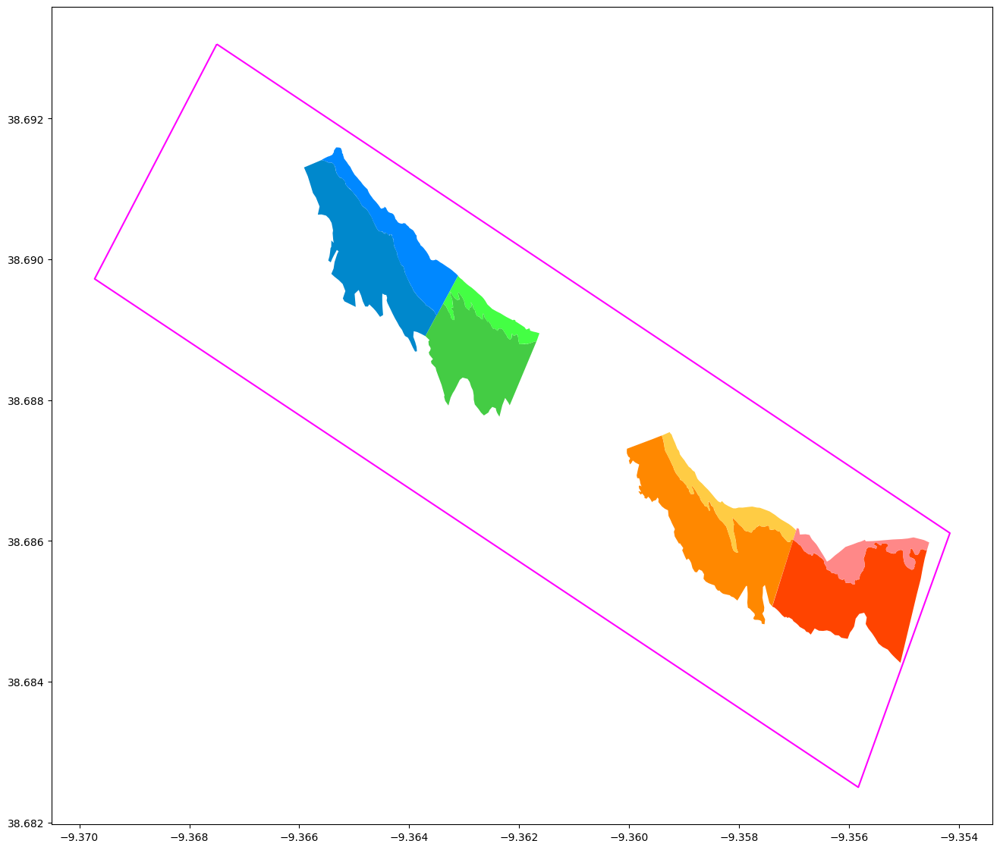

In [31]:
fig, ax = plt.subplots(1,1,figsize=(16,16))

colors = [
    "#08C", "#4C4", "#F80", "#F40",
    "#08F", "#4F4", "#FC4", "#F88"
]

for i, zone in enumerate(gdf_sampling_areas):
    gdf_sampling_areas[zone].to_crs("WGS84").plot(ax=ax, color=colors[i]);

gdf_ampa.boundary.plot(ax=ax, color="#F0F");


Just to confirm, the sampling regions are inside the defined AMPA region.

The provided shape files have the coordinates in Projected CRS: ESRI:102161, this means that the units are in meters.

In [32]:
zones_areas = {
    zone: gdf_sampling_areas[zone].geometry.area.values[0]
    for zone in gdf_sampling_areas
}
for zone in zones_areas:
    print("{:9}: {:.2f} m²".format(zone, zones_areas[zone]))

A_Medium : 21819.17 m²
B_Medium : 18074.15 m²
D_Medium : 25333.58 m²
E_Medium : 25395.50 m²
A_Supra  : 10414.34 m²
B_Supra  : 4095.51 m²
D_Supra  : 6551.86 m²
E_Supra  : 5583.40 m²


According to the provided report the sampling methodology involves:
* The observation of the coverage of the sessil species by using a 0.5 x 0.5 meter square.
* The observation of the mobil species specimens in transects of 10m x 2m.
* The locations for the observations is defined randomly from a fixed set of points.
* Each zone (A,B,D,E) and section (Supra/Mediumlittoral) has a different number of sampling points per sampling session, from the QA session presented report:
| Zone               | Reported Area | Computed Area  | Sampling points | Transects |
| ------------------ | ------------- | -------------- | --------------- | --------- |
| Surpalitoral - A   | 10327         | 10414          | 3               | 3         |
| Surpalitoral - B   | 4012          | 4095           | 1               | 1         |
| Surpalitoral - D   | 6500          | 6551           | 2               | 2         |
| Surpalitoral - E   | 5500          | 5583           | 2               | 2         |
| Mediolitoral - A   | 21843         | 21819          | 4               | 4         |
| Mediolitoral - B   | 17700         | 18074          | 3               | 3         |
| Mediolitoral - D   | 20000         | <span style="color:red">25334</span>          | 3               | 3         |
| Mediolitoral - E   | 25350         | 25396          | 4               | 4         |

The reported areas mostly match when compared with the computed areas from the shape files provided, Mediumlittoral - D shows a discrepancy. While the computation of the area is subjected to projection distortions, it is rather odd that such difference exists.

From the sampling data, the reports matches the number of sampling points per session for the described zones.

In [33]:
sampling_points = {
    "A_Supra"  : 3,
    "B_Supra"  : 1,
    "D_Supra"  : 2,
    "E_Supra"  : 2,
    "A_Medium" : 4,
    "B_Medium" : 3,
    "D_Medium" : 3,
    "E_Medium" : 4
}

reported_areas = {
    "A_Supra"  : 10327,
    "B_Supra"  : 4012,
    "D_Supra"  : 6500,
    "E_Supra"  : 5500,
    "A_Medium" : 21843,
    "B_Medium" : 17700,
    "D_Medium" : 20000,
    "E_Medium" : 25350    
}

In [34]:
sessil_sampling_ratio = {
    zone: (0.5 * 0.5 * sampling_points[zone]) / reported_areas[zone] * 100
    for zone in sampling_points
}
print("Sessil Sampling Ratios:")
for k in sessil_sampling_ratio:
    print("{:10}: {:.4f}%".format(k, sessil_sampling_ratio[k]))

mobil_sampling_ratio = {
    zone: (2 * 10 * sampling_points[zone]) / reported_areas[zone] * 100
    for zone in sampling_points
}
print("\nMobil Sampling Ratios:")
for k in mobil_sampling_ratio:
    print("{:10}: {:.4f}%".format(k, mobil_sampling_ratio[k]))


Sessil Sampling Ratios:
A_Supra   : 0.0073%
B_Supra   : 0.0062%
D_Supra   : 0.0077%
E_Supra   : 0.0091%
A_Medium  : 0.0046%
B_Medium  : 0.0042%
D_Medium  : 0.0037%
E_Medium  : 0.0039%

Mobil Sampling Ratios:
A_Supra   : 0.5810%
B_Supra   : 0.4985%
D_Supra   : 0.6154%
E_Supra   : 0.7273%
A_Medium  : 0.3663%
B_Medium  : 0.3390%
D_Medium  : 0.3000%
E_Medium  : 0.3156%


One point that is evident is the lack of spatial sampling:
* for the sessil species each session samples less than 0.01% of each area
* for the mobil species each session samples less than 1% of each area

Considering the low frequency (see Time sampling below), the probable non homogeneity (non uniform distribution) of the specimens, the sampling effort is simply too weak to offer precise results that show the state of the populations in the several zones.

#### Time sampling

How frequent is the sampling of the species in the shore.

Here we perceive when the data is sampled to check for possible holes or other anomalies.

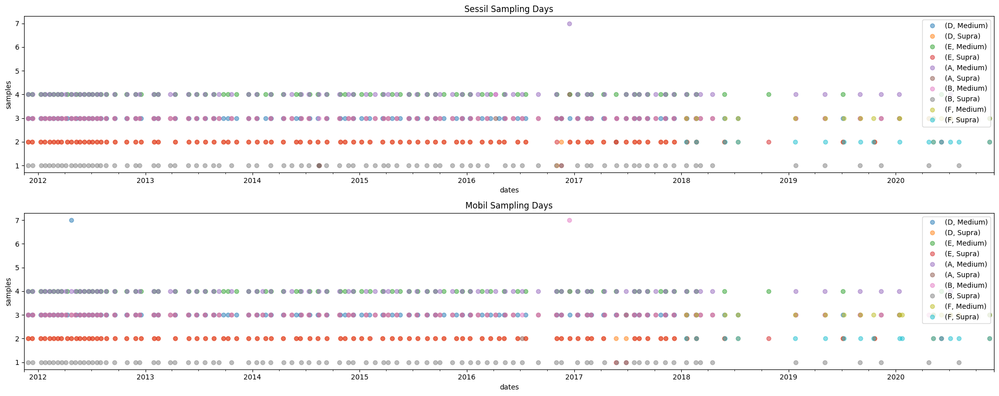

In [35]:
fig, axs = plt.subplots(2, 1, figsize=(20, 8), squeeze = False)

df_plot = df_sessil.groupby(["Date", "Zone", "Supratidal/Middle Intertidal"]).size().reset_index().pivot(index="Date", columns=["Zone", "Supratidal/Middle Intertidal"], values=[0])
df_plot.columns = [t[1:] for t in df_plot.columns]
df_plot.reset_index().merge(
    pd.DataFrame(pd.Series(pd.date_range(datetime(2011, 11, 15), datetime(2020, 12, 1), freq='D')), columns=["dates"]),
    left_on=["Date"],
    right_on=["dates"],
    how='outer'
).sort_values(by=["dates"]).set_index("dates").drop(columns=["Date"]).plot(
    marker='o',
    ls='',
    alpha=0.5,
    ax=axs[0][0]
);

df_plot = df_mobil.groupby(["Date", "Zone", "Supratidal/Middle Intertidal"]).size().reset_index().pivot(index="Date", columns=["Zone", "Supratidal/Middle Intertidal"], values=[0])
df_plot.columns = [t[1:] for t in df_plot.columns]
df_plot.reset_index().merge(
    pd.DataFrame(pd.Series(pd.date_range(datetime(2011, 11, 15), datetime(2020, 12, 1), freq='D')), columns=["dates"]),
    left_on=["Date"],
    right_on=["dates"],
    how='outer'
).sort_values(by=["dates"]).set_index("dates").drop(columns=["Date"]).plot(
    marker='o',
    ls='',
    alpha=0.5,
    ax=axs[1][0]
);

axs[0][0].set_ylabel("samples")
axs[1][0].set_ylabel("samples")

axs[0][0].set_title("Sessil Sampling Days")
axs[1][0].set_title("Mobil Sampling Days")

plt.legend()
plt.tight_layout()
plt.show()

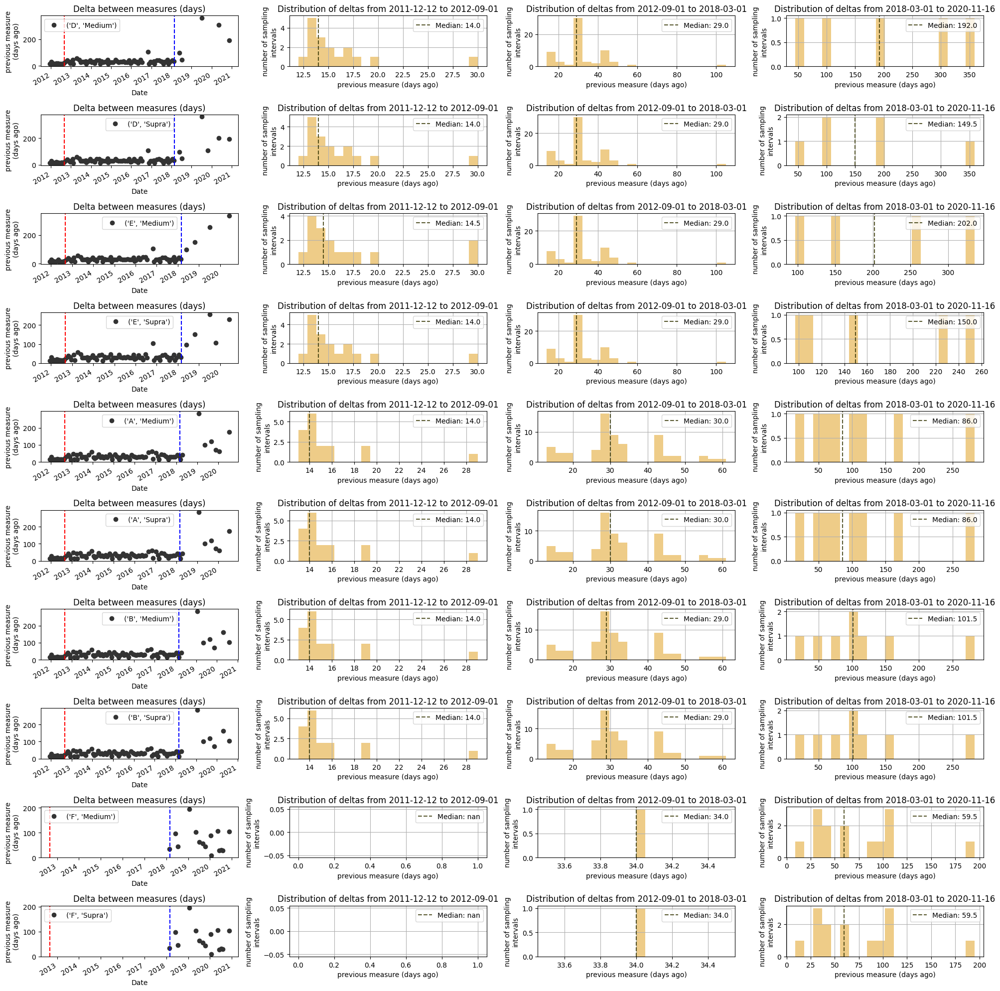

In [36]:
df = df_mobil.groupby(["Date", "Zone", "Supratidal/Middle Intertidal"]).size().reset_index().pivot(
    index="Date",
    columns=["Zone", "Supratidal/Middle Intertidal"],
    values=[0]
)

zone_cols = [(z,s) for v, z, s in df.columns]
df.columns = zone_cols

df.sort_index(inplace=True)
df.reset_index(inplace=True)

df_diffs = None
for col in zone_cols:
    _df = pd.Series(df.loc[~df.get(col).isna(), "Date"], name="Date").to_frame()
    _df[col] = _df["Date"].diff().dt.days
    _df = _df[~_df[col].isna()]
    if df_diffs is None:
        df_diffs = _df.set_index("Date")
    else:
        df_diffs = df_diffs.merge(_df.set_index("Date"), how='outer', left_index=True, right_index=True)

first_split = datetime(2012, 9, 1)
second_split = datetime(2018, 3, 1)

fig, axs = plt.subplots(len(zone_cols), 4, figsize=(20, 20))

for i, col in enumerate(zone_cols):

    # Scatter plot:
    df_diffs[col].plot(kind='line', ax=axs[i][0], style='o', color="#333");
    axs[i][0].legend([col])

    axs[i][0].axvline(first_split, color="red", ls='--')
    axs[i][0].axvline(second_split, color="blue", ls='--')

    axs[i][0].set_title("Delta between measures (days)")
    axs[i][0].set_ylabel("previous measure\n(days ago)")

    # Distribution plots:

    # First distribution:
    data = df_diffs[df_diffs.index < first_split][col]
    data.hist(ax=axs[i][1], bins=20, color="#EC8")
    ref = data.median() if (~data.isna()).sum() > 0 else np.nan
    axs[i][1].axvline(ref, color="#330", alpha=0.8, ls='--', label="Median: {:.1f}".format(ref))
    axs[i][1].legend()

    axs[i][1].set_title("Distribution of deltas from {} to {}".format(
        min(df_diffs.index).strftime("%Y-%m-%d"),
        first_split.strftime("%Y-%m-%d")
    ))
    axs[i][1].set_ylabel("number of sampling\nintervals")
    axs[i][1].set_xlabel("previous measure (days ago)")

    # Second distribution:
    data = df_diffs[(df_diffs.index >= first_split) & (df_diffs.index < second_split)][col]
    data.hist(ax=axs[i][2], bins=20, color="#EC8")
    ref = data.median() if (~data.isna()).sum() > 0 else np.nan
    axs[i][2].axvline(ref, color="#330", alpha=0.8, ls='--', label="Median: {:.1f}".format(ref))
    axs[i][2].legend()

    axs[i][2].set_title("Distribution of deltas from {} to {}".format(
        first_split.strftime("%Y-%m-%d"),
        second_split.strftime("%Y-%m-%d")
    ))
    axs[i][2].set_ylabel("number of sampling\nintervals")
    axs[i][2].set_xlabel("previous measure (days ago)")
    
    # Thrid distribution:
    data = df_diffs[df_diffs.index >= second_split][col]
    data.hist(ax=axs[i][3], bins=20, color="#EC8")
    ref = data.median() if (~data.isna()).sum() > 0 else np.nan
    axs[i][3].axvline(ref, color="#330", alpha=0.8, ls='--', label="Median: {:.1f}".format(ref))
    axs[i][3].legend()

    axs[i][3].set_title("Distribution of deltas from {} to {}".format(
        second_split.strftime("%Y-%m-%d"),
        max(df_diffs.index).strftime("%Y-%m-%d")
    ))
    axs[i][3].set_ylabel("number of sampling\nintervals")
    axs[i][3].set_xlabel("previous measure (days ago)")
    
plt.tight_layout()
plt.show()

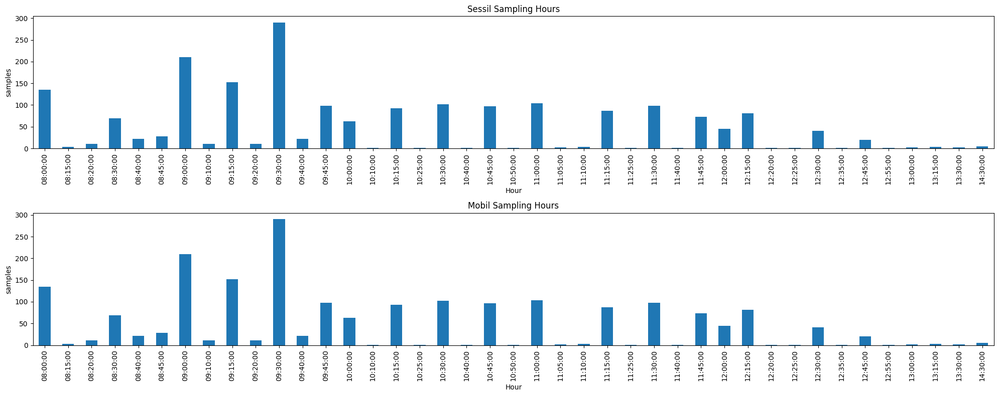

In [37]:
fig, axs = plt.subplots(2, 1, figsize=(20, 8), squeeze = False)

df_sessil.groupby(["Hour"]).size().sort_index().plot(
    kind='bar',
    ax=axs[0][0]
);

df_sessil.groupby(["Hour"]).size().sort_index().plot(
    kind='bar',
    ax=axs[1][0]
);

axs[0][0].set_ylabel("samples")
axs[1][0].set_ylabel("samples")

axs[0][0].set_title("Sessil Sampling Hours")
axs[1][0].set_title("Mobil Sampling Hours")

plt.tight_layout()
plt.show()

From the charts above we observe:
* Both Sessil and Mobil follow a similar sampling pattern, this is in agreement with the sampling methods documented in https://ambiente.cascais.pt/pt/page/monitorizacao-biologica-da-amp-das-avencas
* In a similar fashion the Zones/Section follow a similar sampling pattern.
* The sampling is done primarily during the morning → Species that are more active during dusk/dawn might not be well represented in the data.
* We can segment the sampling in 3 distinct patterns over time:
    * The first two thirds of the have a common sampling frequency around 14 days.
    * From roughly 2012-09-01 to 2018-03-01 have a common sampling frequency around 30 days.
    * After around 2018-03-01 the sampling rate goes to values of 100 days or so. 

Given how the sample of data is done in space, with random locations each time, the sparse temporal sample frequency is inadequate to express the population of the species in the Zones/Sections defined.

In simpler words, using an analogy, the sampling feels like watching a movie with a black cardboard over the screen where sometimes a few holes are randomly made and covered right away.<br>In the end we can't see the movie, like we can't perceive the distribution of the species in the sampled regions.

#### Sessil Species

**Check zeros and sampling days by specie**

In [38]:
with pd.option_context("display.max_rows", None):
    display(pd.Series(((df_sessil[sessil_species_columns] == 0).sum(axis=0) / len(df_sessil)).sort_values(ascending=False), name="Ratio of zeros").to_frame())

,Ratio of zeros
Pollicipes pollicipes,1.000000
Didemnum sp. (ascídeas brancas),0.999498
Alga verde carnuda ramificada,0.999498
Anémona N.I.,0.999498
Cerianthidae,0.999498
Ophiothrix sp.,0.999498
"Alga vermelha ""encaracolada"" (que parece ceramium pequeno)",0.999498
Codium adhaerens (tipo nenúfar),0.998996
Alga branca ramificada,0.998996
Osmundea pinnatifida,0.998996


In [39]:
print("Number of days in the sampling interval:\n{}\n".format((df_sessil["Date"].max() - df_sessil["Date"].min()).days))

print("Number of sampling days:\n")

display(df_sessil.groupby(["Zone", "Supratidal/Middle Intertidal"])["Date"].nunique().to_frame().T)

with pd.option_context("display.max_rows", None):
    display(
        df_sessil.groupby(["Zone", "Supratidal/Middle Intertidal", "Date"])[sessil_species_columns].sum().reset_index().groupby(["Zone", "Supratidal/Middle Intertidal"]).agg(
            {s: lambda v: (v>0).sum() for s in sessil_species_columns}
        ).T
    )

Number of days in the sampling interval:
3276

Number of sampling days:



Zone                              A            B            D            E  \
Supratidal/Middle Intertidal Medium Supra Medium Supra Medium Supra Medium   
Date                             89    91     88    87     86    87     84   

Zone                                    F        
Supratidal/Middle Intertidal Supra Medium Supra  
Date                            86     16    16

Zone                                                    A            B        \
Supratidal/Middle Intertidal                       Medium Supra Medium Supra   
Chthamalus sp.                                         66    64     53    58   
Balanus perforatus                                     46     4     37     0   
Patella sp.                                            75    49     55    46   
Siphonaria algesirae                                   46    42     44    42   
Gibbula sp.                                            81    41     72    31   
Monodonta lineata                                      18    42     17    23   
Littorina neritoides                                   10    50      3    36   
Mytillus sp.                                           66    30     51    30   
Nassariidae (búzio)                                    11     0     21     0   
Chiton sp.                                              0     1      1     0   
Pollicipes pollicipes                                   0     0      0     0   
Actinia equina                                         32    16     15    18   
Anemonia sulcata                                       30     3     13     1   
Ophiothrix sp.                                          0     0      1     0   
Paracentrotus lividus                                  51     0     10     0   
Hymeniacidon sanguinea                                 63     5     68     2   
Aglaophenia pluma (hidrozoário branco ramificado)       5     0      3     0   
Alga branca ramificada                                  1     0      0     0   
Sabellaria alveolata  (tubos)                           0     0      3     0   
Cerianthidae                                            1     0      0     0   
Anémona N.I.                                            1     0      0     0   
Actinia fragacea                                        3     0      0     0   
Gymnangium montagui                                     0     0      0     0   
Anémona branca com estrias (fam. Cerianthidae)          5     1      3     0   
Actinothoe sphyrodeta (anémona branca e laranja)        1     0      0     0   
Oncidiella celtica (lesma)                              1     1      0     0   
Calliostoma sp. (burrié bicudo)                         0     1      1     0   
Polysyncraton sp. (ascídias vermelhas)                  2     0      0     0   
Didemnum sp. (ascídeas brancas)                         1     0      0     0   
Burrié negro N.I.                                      11     1     15     4   
Búzio/burrié n.i.                                       1     0      1     0   
Watersipora subtorquata (Ascídea)                       0     0      1     0   
Verrucaria maura                                        4    17      5     6   
Lichina pygmaea (líquene folhoso)                       7    10      2     8   
Coralina elongata                                      85    21     88    17   
Lithophillum incrustans                                78    25     76    23   
Litophylum lichenoides                                  2     0      0     0   
Litophylum tortuosum                                   14     1      6     2   
Mesophylum lichenoides                                 16     0      4     0   
Gelidium sp. (tipo raquete)                            63    18     48    10   
Asparagopsis armata (tufosa)                           25     0     18     1   
Asparagopsis armata (adulta)                           36     0     28     0   
Porphyra sp.                                            5     3      2     4   
Ceramium (forma taças)                                 46     1     34     2   
Mastocarpus sp. (alga preta só mediolitoral)           44     3     40     1   
Gigartina sp. (língua do diabo)                        22     4     24     4   
Plocamium sp.                                          16     0      7     0   
Caulacanthus sp.                                       65    14     59     6   


For a great number of species we have an insufficient amount of samples to estimate the population or predict its evolution.

To deal with this challenge we have to aggregate the species into groups so that some numerical strengh is obtained.

Note that the sampling interval covers 3276 days but we have at most 91 days with samples for a given zone, this represents less than 3% of the days. Furthermore, the samples fall only in the mornings, meaning that any hourly behaviour (for example, animals that active at dawn/dusk are not sampled that well)

**Global sampled averages**

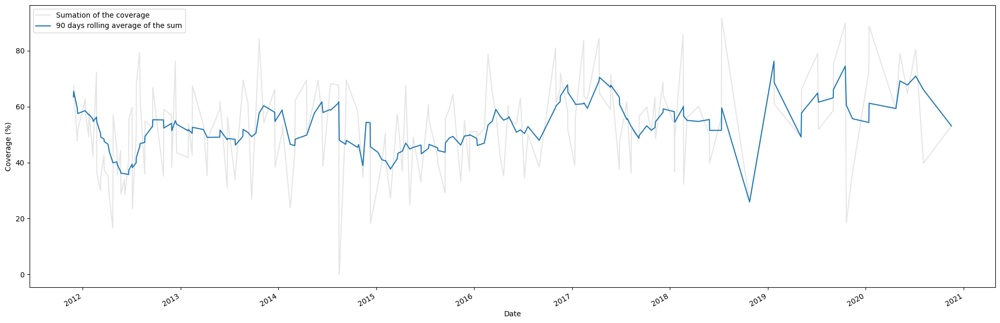

In [40]:
# Daily mean for each specie:
df_sessil_global_mean = df_sessil.groupby(["Date"])[sessil_species_columns].mean()

# 90 Day Rolling average plot
df_sessil_global_mean.sum(axis=1).plot(legend=True, alpha=0.5, color="#CCC", label="Sumation of the coverage", ylabel="Coverage (%)");
df_sessil_global_mean.sum(axis=1).rolling("90D").mean().plot(figsize=(24,8), legend=True, label="90 days rolling average of the sum");

Globably there is not perceived seasonality for the sessil species coverage.

The irregular values are probably related with the lack of precision from the sampling method used.

**Per species global average coverage**

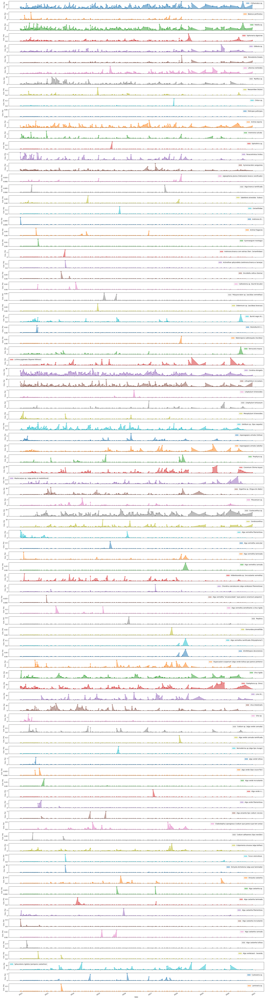

In [41]:
df_sessil_global_mean.plot(kind="area", figsize=(24,90), legend=True, subplots=True, ylabel="Cov. (%)", alpha=0.5, style="o--");

plt.tight_layout()

Again the irregular values are probably related with the lack of precision from the sampling method used.

This makes it very hard to accurately perceive the actual state of the shore population at a given time.

**Check Barnacles and Mussels species.**

These species have a long lifespan and don't move, they should be relatively stable with a well sampled methodology, unless some major abnormal event occurs (ex: extreme weather)

We look into these to perceive the adequacy of the the sampling methodology as we suspect it is not enough to indicate the state of the sessil population at a given time or how it evolves over time.

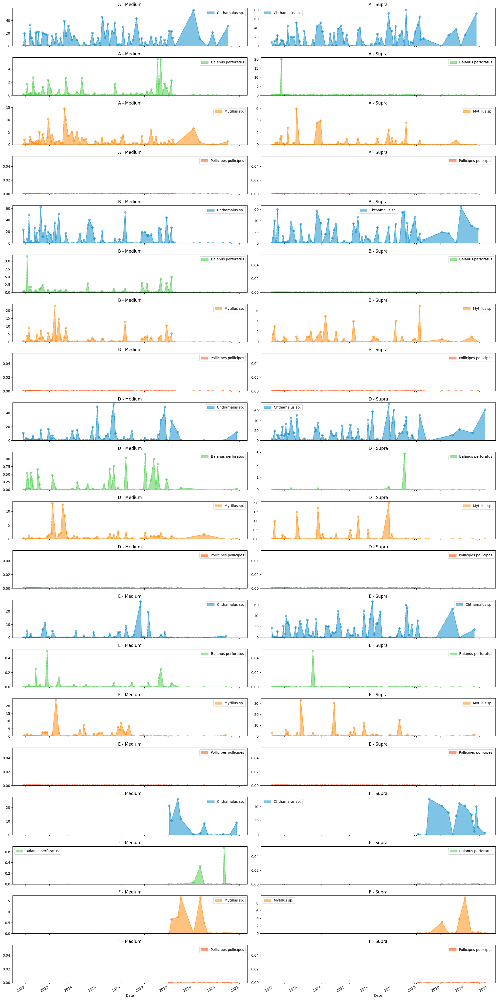

In [42]:
selection = [
    "Chthamalus sp.",
    "Balanus perforatus",
    "Mytillus sp.",
    "Pollicipes pollicipes"
]

selection_colors = [
    "#08C",
    "#4C4",
    "#F80",
    "#F40"
]

zones = sorted(df_sessil["Zone"].unique())
sections = sorted(df_sessil["Supratidal/Middle Intertidal"].unique())

fig, axs = plt.subplots(len(zones)*len(selection), len(sections), figsize=(20,2*len(zones)*len(selection)), sharex=True)

for i, zone in enumerate(zones):
    for k, selected in enumerate(selection):
        for j, section in enumerate(sections):
            df = df_sessil.loc[(df_sessil["Zone"] == zone) & (df_sessil["Supratidal/Middle Intertidal"] == section), ["Date", *selection]]
    
            axs[i*len(selection)+k][j].set_title("{} - {}".format(zone, section))
    
            df.groupby(["Date"])[selected].mean().plot(kind='area', style='o--', legend=True, ax=axs[i*len(selection)+k][j], color=selection_colors[k], alpha=0.5)

plt.legend()
plt.tight_layout()
plt.show()

The sampling of the data is inadequate for sessil species, it doesn't represent the Zone/Section.

Due to the rarity of some species, a maximum aggregation with a rolling window is recommended, however this will lose precision over the time axis.

Aggregating similar species might also help out in the sampling effort, but in the case of sessil species as the sample area is very small this might simply not work.

As it stands sessil data is unusable.

#### Mobil Species

**Check zeros and sampling days by specie**

In [43]:
with pd.option_context("display.max_rows", None):
    display(pd.Series(((df_mobil[mobil_species_columns] == 0).sum(axis=0) / len(df_mobil)).sort_values(ascending=False), name="Ratio of zeros").to_frame())

,Ratio of zeros
Sepia officinallis,1.000000
Loligo vulgaris,1.000000
Alloteuthis subulata,1.000000
Podarcis carbonelli,1.000000
Diplodus vulgaris,0.999501
Maja sp.,0.999501
Chromodoris purpurea (nudibrânquio),0.999501
Gobiusculus flavescens,0.999501
Scorpaena sp. (Rascasso),0.999501
Anémona n.i.,0.999501


In [44]:
print("Number of days in the sampling interval:\n{}\n".format((df_mobil["Date"].max() - df_mobil["Date"].min()).days))

print("Number of sampling days:\n")

display(df_mobil.groupby(["Zone", "Supratidal/Middle Intertidal"])["Date"].nunique().to_frame().T)

with pd.option_context("display.max_rows", None):
    display(
        df_mobil.groupby(["Zone", "Supratidal/Middle Intertidal", "Date"])[mobil_species_columns].sum().reset_index().groupby(["Zone", "Supratidal/Middle Intertidal"]).agg(
            {s: lambda v: (v>0).sum() for s in mobil_species_columns}
        ).T
    )

Number of days in the sampling interval:
3276

Number of sampling days:



Zone                              A            B            D            E  \
Supratidal/Middle Intertidal Medium Supra Medium Supra Medium Supra Medium   
Date                             89    89     90    90     86    87     83   

Zone                                    F        
Supratidal/Middle Intertidal Supra Medium Supra  
Date                            86     16    16

Zone                                                    A            B        \
Supratidal/Middle Intertidal                       Medium Supra Medium Supra   
Caboz N.I.                                             43    24     38     6   
Palaemon serratus                                      36    31     43     8   
Nasariidae (búzio)                                     17     2     25     0   
Diogenes pugilator                                      8     0      4     0   
Marthasterias glacialis                                15     0     13     0   
Asterina gibbosa                                        3     0      2     0   
Eulalia viridis (poliqueta)                            30     1     37     1   
Sabellaria alveolata                                    1     0      1     0   
Octopus vulgaris                                        4     1      3     0   
Sepia officinallis                                      0     0      0     0   
Alloteuthis subulata                                    0     0      0     0   
Loligo vulgaris                                         0     0      0     0   
Parablennius gattorugine                                4     1      1     0   
Diplodus sp.                                            1     1      0     0   
Diplodus sargus                                         0     0      2     0   
Maja sp.                                                0     0      0     0   
Eriphia verrucosa                                       6     2      3     2   
Polybius henslowii                                      0     0      1     0   
Necora puber                                            7     0      1     1   
Aplysia punctata                                        3     0      1     0   
Podarcis carbonelli                                     0     0      0     0   
Acanthochitona fascicularis                             0     0      0     0   
Sphaeroma sp. (bicho de conta)                          1     0      3     0   
Chromodoris purpurea (nudibrânquio)                     1     0      0     0   
Lipophrys pholis (juvenil/recruta)                      1     0      1     0   
Pomatoschistus pictus (caboz-de-areia)                  2     0      1     0   
Peixe juvenil N.I.                                      2     1      3     0   
Juvenis de lagosta/lavagante                            1     0      0     0   
caranguejo N.I.                                         4     3      3     0   
Xantho sp.                                              4     0      8     0   
Carcinus maenas                                        11     5     20     0   
Atherina presbyter                                      1     1      0     0   
Diplodus vulgaris                                       0     0      0     0   
Syngnathus (Marinha)                                    1     0      1     0   
Lepadogaster lepadogaster                               5     0      3     0   
Poliqueta n.i.                                          0     0      0     0   
Nereis sp.                                              0     1      0     0   
Ofiurídeo n.i.                                          9     0      8     0   
Chiton sp.                                              6     0      7     0   
Acanthochitona fascicularis (quíton com pêlos)          1     0      2     0   
Leptochiton cancellatus                                 1     0      0     0   
Anémona n.i.                                            1     0      0     0   
Pagurus sp. (caranguejo eremita)                        1     0      0     1   
Pachygrapsus marmoratus (caranguejo pequeno verde)      5     9      4     0   
Porcellana sp. (caranguejo pinças largas)               0     0      1     0   
Palaemon sp.                                            1     0      0     0   
Gobius sp.                                              5     4      5     0   
Parablennius sp. (marachomba)                           0     1      0     0   


Like for the sessil species, with the mobil species we have an insufficient amount of samples to estimate the population or predict its evolution in many of them.

**Global sampled averages**

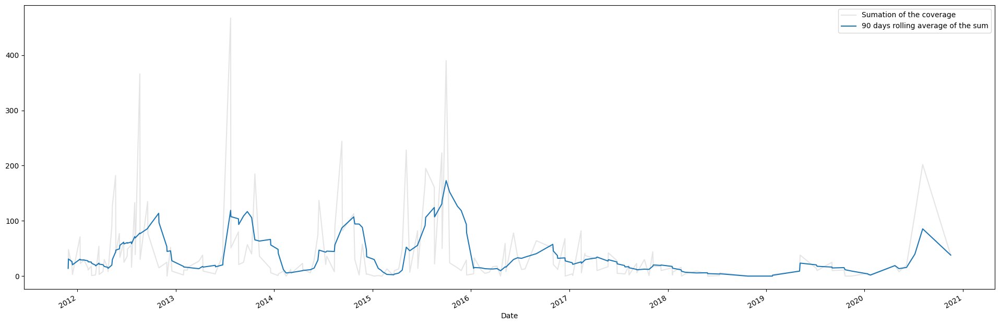

In [45]:
# Daily mean
df_mobil_global_mean = df_mobil.groupby(["Date"])[mobil_species_columns].sum()

# 90 Day Rolling average plot
df_mobil_global_mean.sum(axis=1).plot(legend=True, alpha=0.5, color="#CCC", label="Sumation of the coverage");
df_mobil_global_mean.sum(axis=1).rolling("90D").mean().plot(figsize=(24,8), legend=True, label="90 days rolling average of the sum");

Globably we can percieve some seasonality in the sampled mobil species.

At the end of 2016 something odd occurred, this break in the seasonality might indicate either some problem with the data or some sort of event or anomaly. (Ex.: Weather, Pollution, etc.)

Again, the irregular values are probably related with the lack of precision from the sampling method used.

**Per species global average coverage**

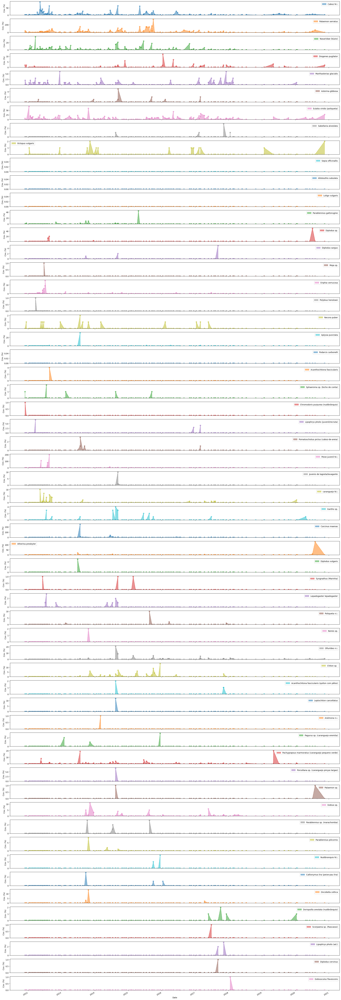

In [46]:
df_mobil_global_mean.plot(kind='area', figsize=(24,70), legend=True, subplots=True, ylabel="Cov. (%)", alpha=0.5, style="o--");

plt.tight_layout()

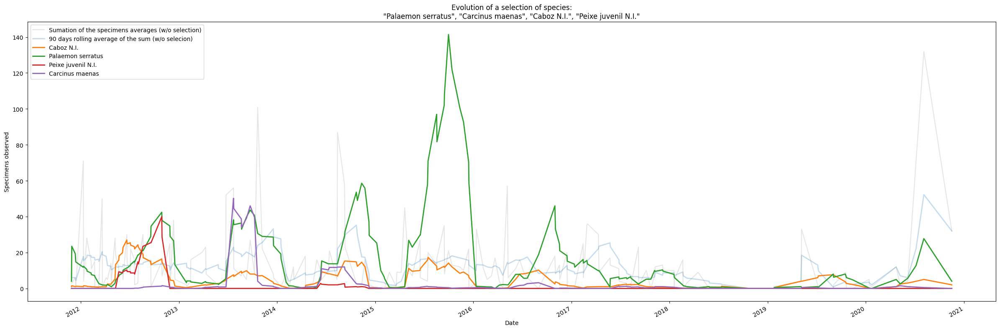

In [47]:
fig, ax = plt.subplots(1, 1, figsize=(24,8))

ax.set_title('Evolution of a selection of species:\n"Palaemon serratus", "Carcinus maenas", "Caboz N.I.", "Peixe juvenil N.I."')

df_mobil_global_mean[
    [
        s for s in mobil_species_columns if s not in ["Palaemon serratus", "Carcinus maenas", "Caboz N.I.", "Peixe juvenil N.I."]
    ]
].sum(axis=1).plot(
    ax=ax,
    legend=True,
    alpha=0.5,
    color="#CCC",
    label="Sumation of the specimens averages (w/o selection)",
    ylabel="Specimens observed"
);

df_mobil_global_mean[
    [
        s for s in mobil_species_columns if s not in ["Palaemon serratus", "Carcinus maenas", "Caboz N.I.", "Peixe juvenil N.I."]
    ]
].sum(axis=1).rolling("90D").mean().plot(
    ax=ax,
    legend=True,
    label="90 days rolling average of the sum (w/o selecion)",
    style='-',
    alpha=0.25,
    lw=2
);

df_mobil_global_mean[
    [
        s for s in mobil_species_columns if s in ["Palaemon serratus", "Carcinus maenas", "Caboz N.I.", "Peixe juvenil N.I."]
    ]
].rolling("90D").mean().plot(
    ax=ax,
    legend=True,
    label="90 days rolling average of the sum (selection)",
    lw=2
);

plt.legend()
plt.tight_layout()
plt.show()

Again the irregular values are probably related with the lack of precision from the sampling method used.

This makes it very hard to accurately percieve the actual state of the shore population at a given time.

The species with more impact in the perceived seasonality are the "Palaemon serratus", "Carcinus maenas", "Caboz N.I." and "Peixe juvenil N.I.".

Notably "Palaemon serratus" (a species of shrimp) had a odd behaviour in 2016 with twice of the observed specimens, this contrasts quite noticeable with the following years where it mostly vanished.

"Carcinus maenas" is a specie of crab, it is quite odd that it had a substantial amount of observations in 2013 and 2014.

**Check Blenny Fish populations.**

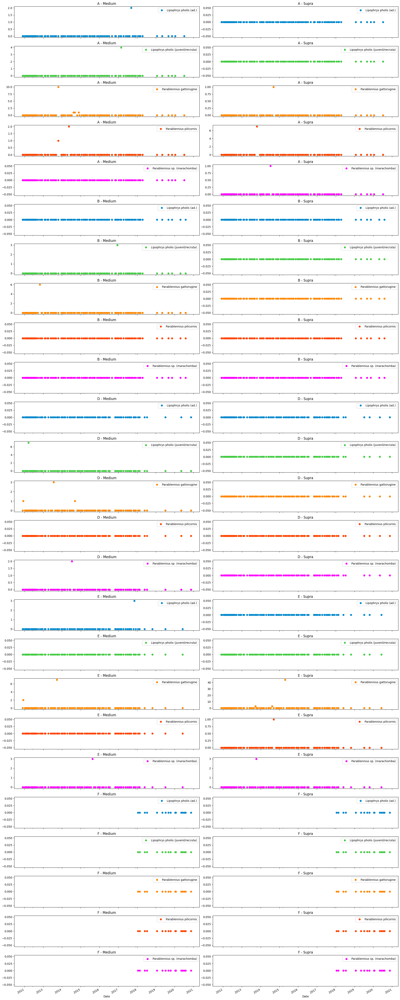

In [48]:
selection = [
    "Lipophrys pholis (ad.)",
    "Lipophrys pholis (juvenil/recruta)",
    "Parablennius gattorugine",
    "Parablennius pilicornis",
    "Parablennius sp. (marachomba)"
]

selection_colors = [
    "#08C",
    "#4C4",
    "#F80",
    "#F40",
    "#F0F"
]

zones = sorted(df_mobil["Zone"].unique())
sections = sorted(df_mobil["Supratidal/Middle Intertidal"].unique())

fig, axs = plt.subplots(len(zones)*len(selection), len(sections), figsize=(20,2*len(zones)*len(selection)), sharex=True)

for i, zone in enumerate(zones):
    for k, selected in enumerate(selection):
        for j, section in enumerate(sections):
            df = df_mobil.loc[(df_mobil["Zone"] == zone) & (df_mobil["Supratidal/Middle Intertidal"] == section), ["Date", *selection]]
    
            axs[i*len(selection)+k][j].set_title("{} - {}".format(zone, section))
    
            df.groupby(["Date"])[selected].sum().plot(style='o', legend=True, ax=axs[i*len(selection)+k][j], color=selection_colors[k])

plt.legend()
plt.tight_layout()
plt.show()

The sampling of the data is inadequate to perceive the Blenny fish population status.

**Check Seabream Fish populations.**

Diplodus species are Commercially Threatened according to the IUCN red list.

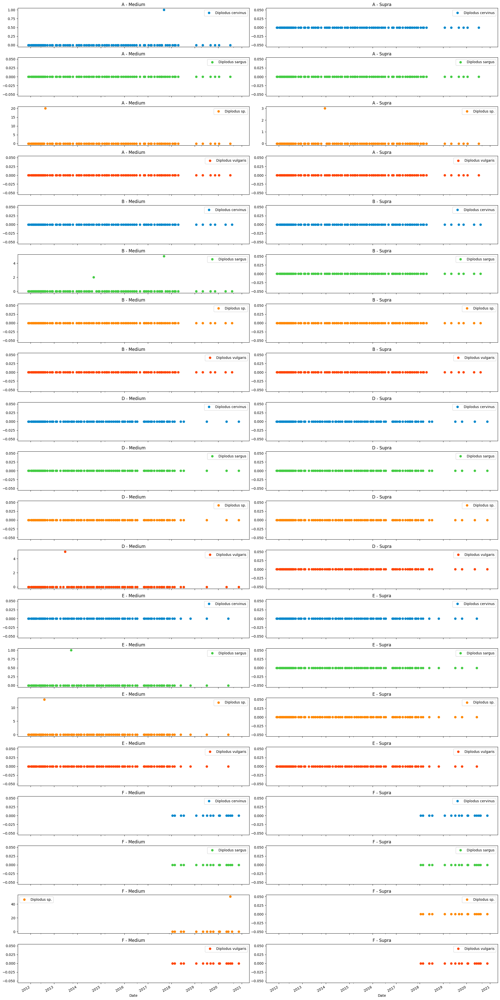

In [49]:
selection = [
    "Diplodus cervinus",
    "Diplodus sargus",
    "Diplodus sp.",
    "Diplodus vulgaris"
]

selection_colors = [
    "#08C",
    "#4C4",
    "#F80",
    "#F40"
]

zones = sorted(df_mobil["Zone"].unique())
sections = sorted(df_mobil["Supratidal/Middle Intertidal"].unique())

fig, axs = plt.subplots(len(zones)*len(selection), len(sections), figsize=(20,2*len(zones)*len(selection)), sharex=True)

for i, zone in enumerate(zones):
    for k, selected in enumerate(selection):
        for j, section in enumerate(sections):
            df = df_mobil.loc[(df_mobil["Zone"] == zone) & (df_mobil["Supratidal/Middle Intertidal"] == section), ["Date", *selection]]
    
            axs[i*len(selection)+k][j].set_title("{} - {}".format(zone, section))
    
            df.groupby(["Date"])[selected].sum().plot(style='o', legend=True, ax=axs[i*len(selection)+k][j], color=selection_colors[k])

plt.legend()
plt.tight_layout()
plt.show()

The sampling of the data is inadequate to perceive the Diplodus population status.

#### Weather analysis

Here we grasp the weather patterns in the location and time interval of the provided species sampling.

We are looking for periods of extreme weather (high winds, high temperatures, low pressures) or other anomalies that might be insightful for the populations in the location

In [50]:
for col in all_weather_data.columns:
    if col != "time":
        print(col)

temperature_2m_best_match
pressure_msl_best_match
rain_best_match
weathercode_best_match
cloudcover_best_match
shortwave_radiation_best_match
direct_radiation_best_match
diffuse_radiation_best_match
direct_normal_irradiance_best_match
windspeed_10m_best_match
winddirection_10m_best_match
windgusts_10m_best_match
soil_temperature_0_to_7cm_best_match
soil_moisture_0_to_7cm_best_match
temperature_2m_cerra
pressure_msl_cerra
rain_cerra
weathercode_cerra
cloudcover_cerra
shortwave_radiation_cerra
direct_radiation_cerra
diffuse_radiation_cerra
direct_normal_irradiance_cerra
windspeed_10m_cerra
winddirection_10m_cerra
windgusts_10m_cerra


In [51]:
# Decompose wind vector components in N-S (y), E-W (x):
radians_angle = (((360-all_weather_data["winddirection_10m_cerra"]) + 270) % 360) * 2*np.pi / 360
all_weather_data["windspeed_10m_cerra_y"] = all_weather_data["windspeed_10m_cerra"] * np.sin(radians_angle)
all_weather_data["windspeed_10m_cerra_x"] = all_weather_data["windspeed_10m_cerra"] * np.cos(radians_angle)

In [52]:
# Create a week truncated datetime column:
all_weather_data_week = all_weather_data.assign(
    day_time=(
        all_weather_data["time"].dt.date - pd.to_timedelta(all_weather_data["time"].dt.dayofweek, unit='d')
    )
)

/tmp/ipykernel_276212/2540093585.py:4: PerformanceWarning: Adding/subtracting object-dtype array to TimedeltaArray not vectorized.
  all_weather_data["time"].dt.date - pd.to_timedelta(all_weather_data["time"].dt.dayofweek, unit='d')


**Temperature metric plots**

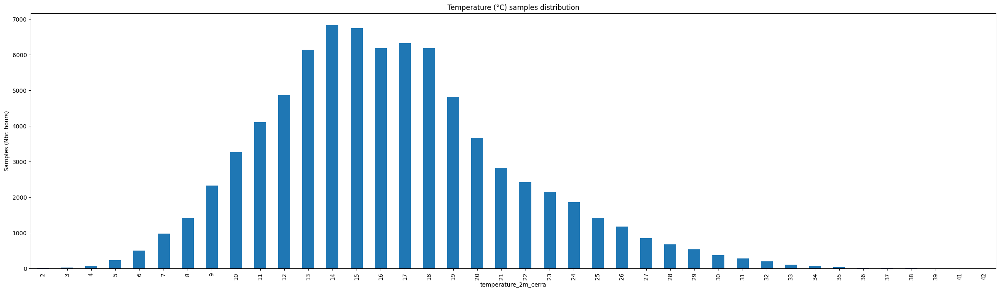

In [53]:
all_weather_data["temperature_2m_cerra"].astype('int').to_frame().groupby(["temperature_2m_cerra"]).size().plot(kind='bar', figsize=(30,8), ylabel="Samples (Nbr. hours)", title="Temperature (°C) samples distribution");

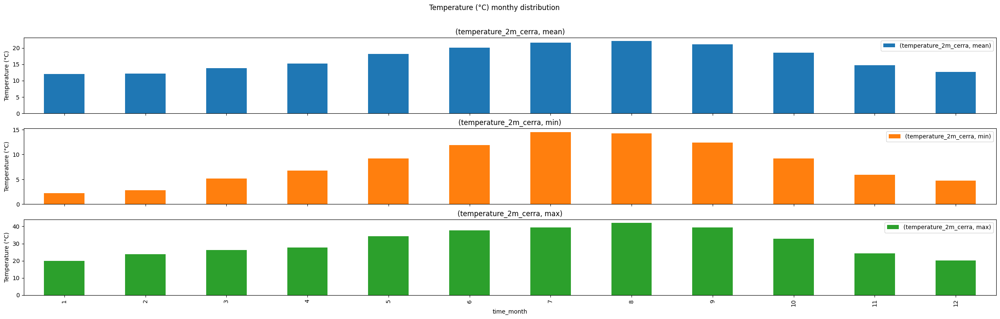

In [54]:
all_weather_data.assign(time_month=all_weather_data["time"].dt.month).groupby(["time_month"]).agg(
    {"temperature_2m_cerra": ["mean", "min", "max"]}
).plot(kind='bar', figsize=(30,8), title="Temperature (°C) monthy distribution", ylabel="Temperature (°C)", subplots=True);

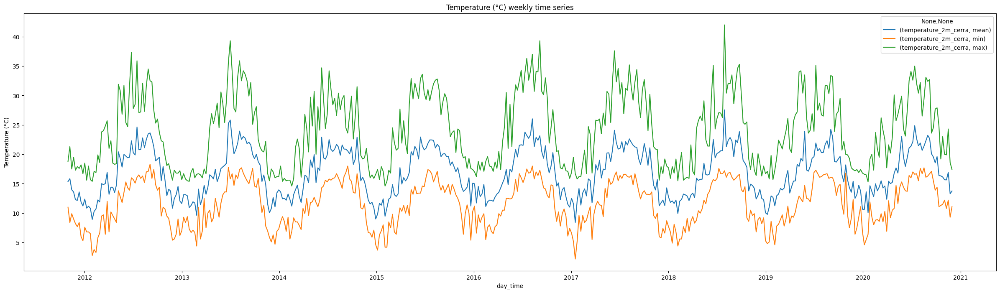

In [55]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"temperature_2m_cerra": ["mean", "min", "max"]}
).plot(figsize=(30,8), title="Temperature (°C) weekly time series", ylabel="Temperature (°C)");

**Wind metrics plots**

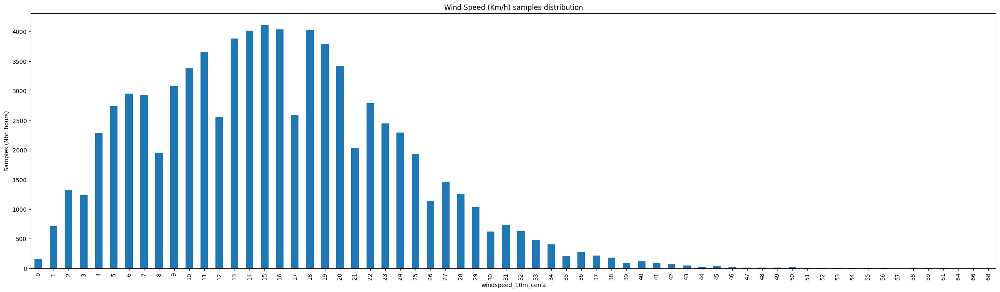

In [56]:
all_weather_data["windspeed_10m_cerra"].astype('int').to_frame().groupby(["windspeed_10m_cerra"]).size().plot(kind='bar', figsize=(30,8), ylabel="Samples (Nbr. hours)", title="Wind Speed (Km/h) samples distribution");

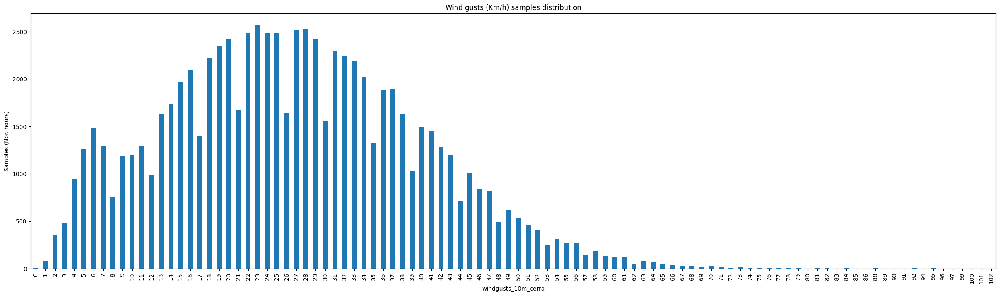

In [57]:
all_weather_data["windgusts_10m_cerra"].astype('int').to_frame().groupby(["windgusts_10m_cerra"]).size().plot(kind='bar', figsize=(30,8), ylabel="Samples (Nbr. hours)", title="Wind gusts (Km/h) samples distribution");

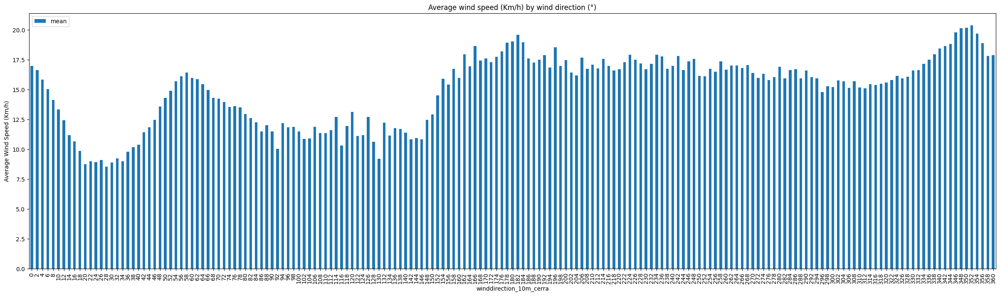

In [58]:
all_weather_data.groupby(["winddirection_10m_cerra"])["windspeed_10m_cerra"].agg(["mean"]).plot(kind='bar', figsize=(30,8), ylabel="Average Wind Speed (Km/h)", title="Average wind speed (Km/h) by wind direction (°)");

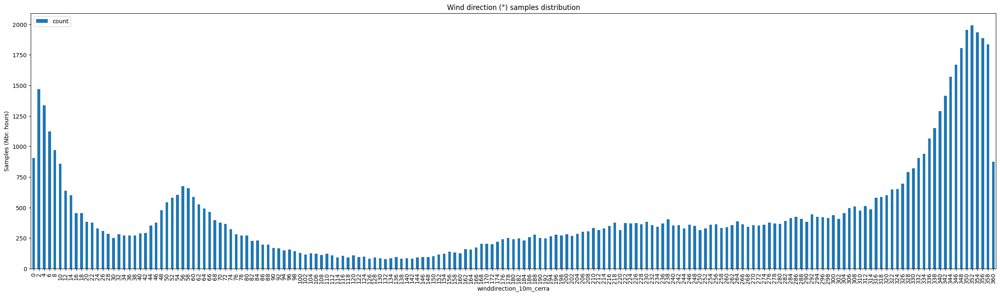

In [59]:
all_weather_data.groupby(["winddirection_10m_cerra"])["windspeed_10m_cerra"].agg(["count"]).plot(kind='bar', figsize=(30,8), ylabel="Samples (Nbr. hours)", title="Wind direction (°) samples distribution");

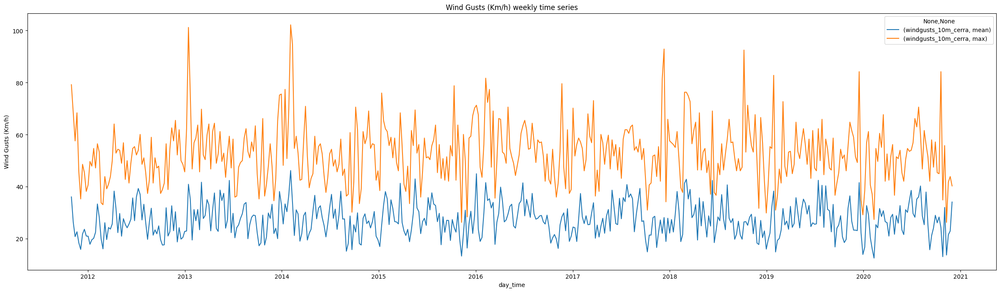

In [60]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"windgusts_10m_cerra": ["mean", "max"]}
).plot(figsize=(30,8), title="Wind Gusts (Km/h) weekly time series", ylabel="Wind Gusts (Km/h)");

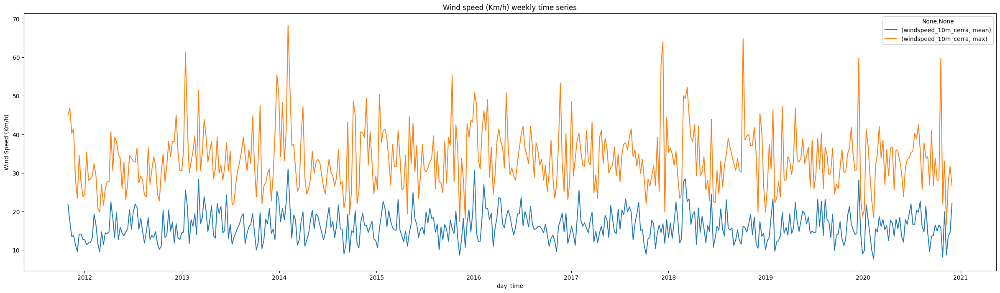

In [61]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"windspeed_10m_cerra": ["mean", "max"]}
).plot(figsize=(30,8), title="Wind speed (Km/h) weekly time series", ylabel="Wind Speed (Km/h)");

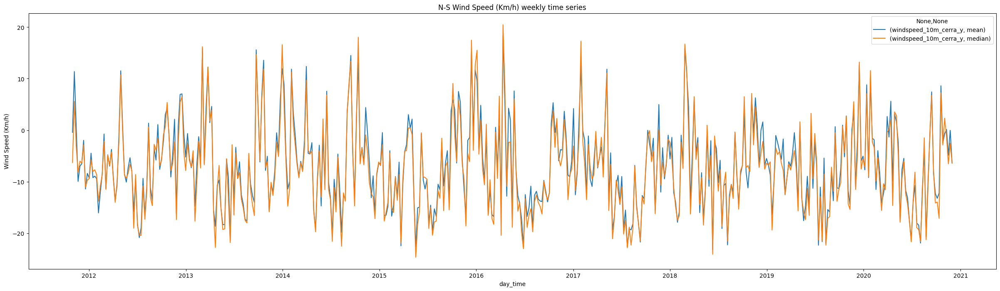

In [62]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"windspeed_10m_cerra_y": ["mean", "median"]}
).plot(figsize=(30,8), title="N-S Wind Speed (Km/h) weekly time series", ylabel="Wind Speed (Km/h)");

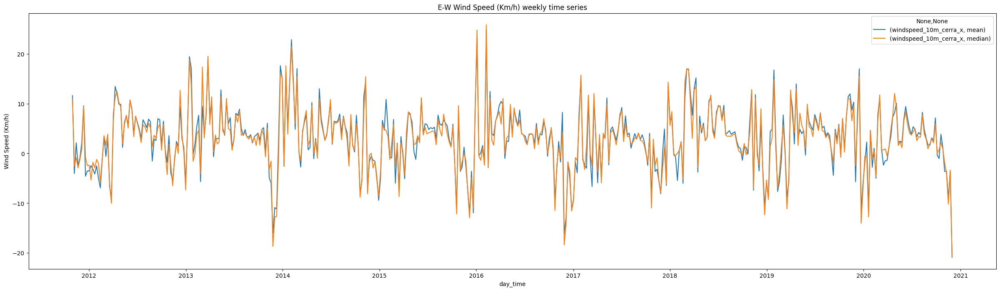

In [63]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"windspeed_10m_cerra_x": ["mean", "median"]}
).plot(figsize=(30,8), title="E-W Wind Speed (Km/h) weekly time series", ylabel="Wind Speed (Km/h)");

**Rain plots**

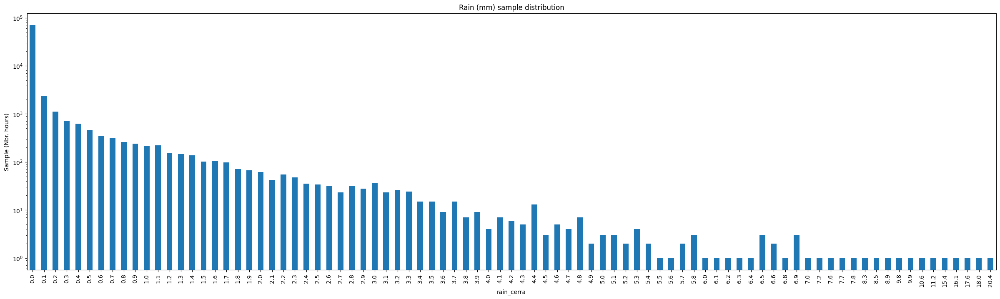

In [64]:
((all_weather_data["rain_cerra"]*10).astype('int')/10).to_frame().groupby(["rain_cerra"]).size().plot(kind='bar', figsize=(30,8), logy=True, ylabel="Sample (Nbr. hours)", title="Rain (mm) sample distribution");

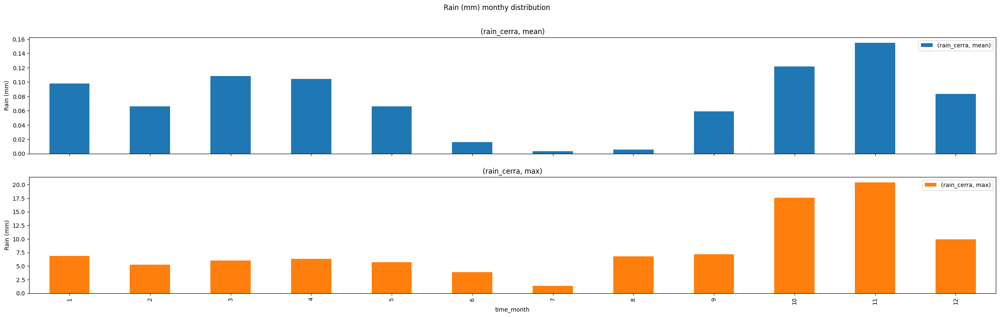

In [65]:
all_weather_data.assign(time_month=all_weather_data["time"].dt.month).groupby(["time_month"]).agg(
    {"rain_cerra": ["mean", "max"]}
).plot(kind='bar', figsize=(30,8), title="Rain (mm) monthy distribution", ylabel="Rain (mm)", subplots=True);

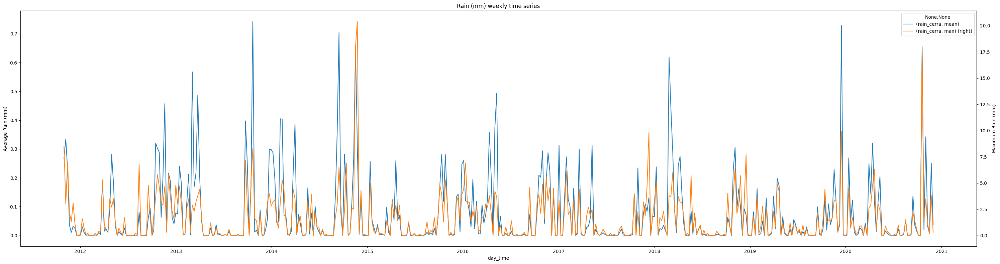

In [66]:
fig, ax = plt.subplots(1,1,figsize=(30,8))

rain_weekly = all_weather_data_week.groupby(["day_time"]).agg(
    {"rain_cerra": ["mean", "max"]}
)


rain_weekly[("rain_cerra", "mean")].plot(ax=ax, title="Rain (mm) weekly time series", ylabel="Average Rain (mm)", legend=True);
rain_weekly[("rain_cerra", "max")].plot( ax=ax, title="Rain (mm) weekly time series", ylabel="Maximum Rain (mm)", secondary_y=True, legend=True);

#plt.legend()
plt.tight_layout()
plt.show()

**Pressure metric plots**

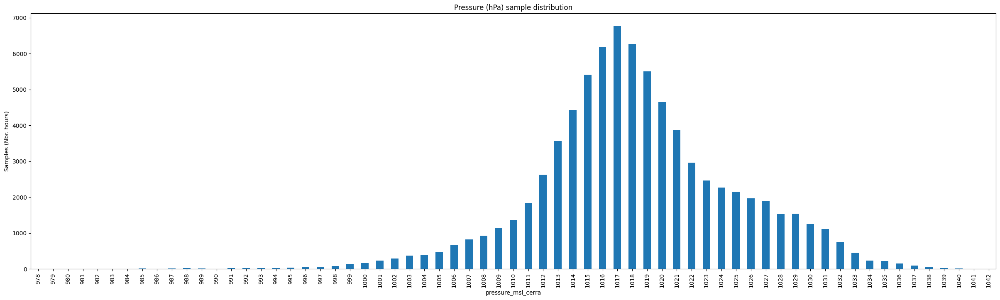

In [67]:
all_weather_data["pressure_msl_cerra"].astype('int').to_frame().groupby(["pressure_msl_cerra"]).size().plot(kind='bar', figsize=(30,8), ylabel="Samples (Nbr. hours)", title="Pressure (hPa) sample distribution");

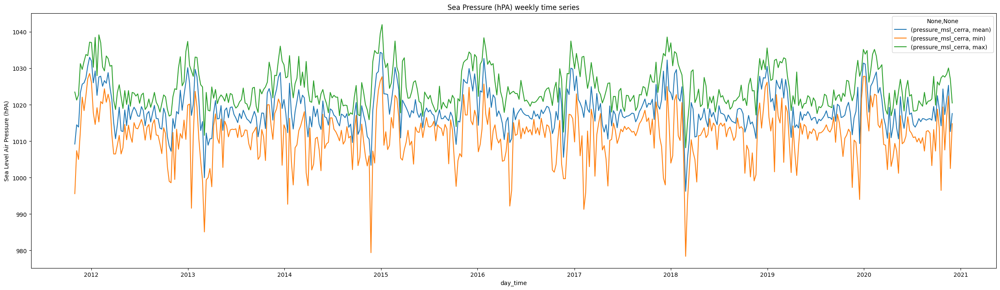

In [68]:
all_weather_data_week.groupby(["day_time"]).agg(
    {"pressure_msl_cerra": ["mean", "min", "max"]}
).plot(figsize=(30,8), title="Sea Pressure (hPA) weekly time series", ylabel="Sea Level Air Pressure (hPA)");

From the weather metrics we see some abnormalities:
* Wind Gusts:
  * At the beginning of 2014 there are severe wind gusts, this matches the "Hercules" storm described in the paper provided.
  * At the beginning of 2013 and in December of 2018, we also have severe wind gusts
* Rain:
  * In November of 2014 and September of 2020 there was intense rain.
  * As expected in June, July and August there is little rain.
  * Rain periods are more intense in October and November, even though the amount of water is only slighly higher.
* Temperature:
  * As expected temperature shows a visible correlation with the seasons.

### Feature Engineering

Sessil species in samples data:

<table border="1">
  <thead>
    <tr style="text-align: left;">
      <th>Sampling Days</th>
      <th>Column</th>
      <th>Invasive</th>
      <th>IUCN</th>
      <th>Group</th>
      <th>Name</th>
      <th>Notes</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td>137</td>
      <td>Actinia equina</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Actinia equina</td>
      <td>Beadlet anemone</td>
    </tr>
    <tr>
      <td>5</td>
      <td>Actinia fragacea</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Actinia fragacea</td>
      <td>Strawberry anemone</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Actinothoe sphyrodeta (anémona branca e laranja)</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Actinothoe sphyrodeta</td>
      <td>Sandalled anemone</td>
    </tr>
    <tr>
      <td>8</td>
      <td>Aglaophenia pluma (hidrozoário branco ramificado)</td>
      <td></td>
      <td></td>
      <td>Hydroid</td>
      <td>Aglaophenia pluma</td>
      <td>toothed feather hydroid</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Ahnfeltiopsis devoniensis</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Ahnfeltiopsis devoniensis</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Alga amarela tipo codium viscoso</td>
      <td></td>
      <td></td>
      <td>?</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga branca ramificada</td>
      <td></td>
      <td></td>
      <td>?</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Alga castanha carnuda</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>22</td>
      <td>Alga castanha filamentosa</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>4</td>
      <td>Alga castanha incrustante</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>7</td>
      <td>Alga castanha laminada</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga castanha sp.</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga castanha tufosa</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>alga verde (tipo couve flor)</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Alga verde carnuda ramificada</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>8</td>
      <td>Alga verde filamentosa</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga verde incrustante</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga verde n.i.</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>6</td>
      <td>alga verde tufosa</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga verde/azul - lavanda</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Alga vermelha "encaracolada" (que parece ceramium pequeno)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Alga vermelha carnuda</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>31</td>
      <td>Alga vermelha filamentosa</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>25</td>
      <td>Alga vermelha laminada</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Alga vermelha ramificada (Polysiphonia?)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>5</td>
      <td>Alga vermelha semelhante a Ulva rigida</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Alga vermelha vesicular</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td></td>
      <td>Generic identification</td>
    </tr>
    <tr>
      <td>10</td>
      <td>Anémona branca com estrias (fam. Cerianthidae)</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Cerianthidae</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Anémona N.I.</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>57</td>
      <td>Anemonia sulcata</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Anemonia sulcata</td>
      <td></td>
    </tr>
    <tr>
      <td>90</td>
      <td>Asparagopsis armata (adulta)</td>
      <td>Yes</td>
      <td></td>
      <td>Red Algea</td>
      <td>Asparagopsis armata</td>
      <td></td>
    </tr>
    <tr>
      <td>72</td>
      <td>Asparagopsis armata (tufosa)</td>
      <td>Yes</td>
      <td></td>
      <td>Red Algea</td>
      <td>Asparagopsis armata</td>
      <td></td>
    </tr>
    <tr>
      <td>108</td>
      <td>Balanus perforatus</td>
      <td></td>
      <td></td>
      <td>Barnacles</td>
      <td>Balanus perforatus</td>
      <td></td>
    </tr>
    <tr>
      <td>51</td>
      <td>Burrié negro N.I.</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Búzio/burrié n.i.</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Calliostoma sp. (burrié bicudo)</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Calliostoma</td>
      <td></td>
    </tr>
    <tr>
      <td>161</td>
      <td>Caulacanthus sp.</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Caulacanthus</td>
      <td></td>
    </tr>
    <tr>
      <td>131</td>
      <td>Ceramium (forma taças)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Ceramium</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Cerianthidae</td>
      <td></td>
      <td></td>
      <td>Sea Anemones</td>
      <td>Cerianthidae</td>
      <td></td>
    </tr>
    <tr>
      <td>4</td>
      <td>Chiton sp.</td>
      <td></td>
      <td></td>
      <td>Chitons</td>
      <td>Chiton</td>
      <td></td>
    </tr>
    <tr>
      <td>52</td>
      <td>Chondria coerulescens (alga verde/azul filamentosa)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Chondria coerulescens</td>
      <td></td>
    </tr>
    <tr>
      <td>189</td>
      <td>Chthamalus sp.</td>
      <td></td>
      <td></td>
      <td>Barnacles</td>
      <td>Chthamalus</td>
      <td></td>
    </tr>
    <tr>
      <td>171</td>
      <td>Cladophora sp. (limo)</td>
      <td>Yes</td>
      <td></td>
      <td>Green Algea</td>
      <td>Cladophora</td>
      <td></td>
    </tr>
    <tr>
      <td>26</td>
      <td>Cladostephus spongiosus (codium que parece que tem areia)</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Cladostephus spongiosus</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Codium adhaerens (tipo nenúfar)</td>
      <td>Yes</td>
      <td></td>
      <td>Green Algea</td>
      <td>Codium adhaerens</td>
      <td></td>
    </tr>
    <tr>
      <td>26</td>
      <td>Codium sp. (alga verde carnuda)</td>
      <td>Yes</td>
      <td></td>
      <td>Green Algea</td>
      <td>Codium</td>
      <td></td>
    </tr>
    <tr>
      <td>137</td>
      <td>Colpomenia sinuosa (alga bolhas)</td>
      <td>Yes</td>
      <td></td>
      <td>Brown Algea</td>
      <td>Colpomenia sinuosa</td>
      <td></td>
    </tr>
    <tr>
      <td>107</td>
      <td>Condracanthus</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Chondracanthus</td>
      <td></td>
    </tr>
    <tr>
      <td>190</td>
      <td>Coralina elongata</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Coralina elongata</td>
      <td></td>
    </tr>
    <tr>
      <td>12</td>
      <td>Cystoseira sp.</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Cystoseira</td>
      <td></td>
    </tr>
    <tr>
      <td>24</td>
      <td>Dictyota castanha</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Dictyota</td>
      <td></td>
    </tr>
    <tr>
      <td>36</td>
      <td>Dictyota dichotoma (alga azul laminada)</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Dictyota dichotoma</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Didemnum sp. (ascídeas brancas)</td>
      <td></td>
      <td></td>
      <td>Tunicates</td>
      <td>Didemnum</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Fucus vesiculosus</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Fucus vesiculosus</td>
      <td></td>
    </tr>
    <tr>
      <td>145</td>
      <td>Gelidium sp. (tipo raquete)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Gelidium</td>
      <td></td>
    </tr>
    <tr>
      <td>183</td>
      <td>Gibbula sp.</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Gibbula</td>
      <td></td>
    </tr>
    <tr>
      <td>86</td>
      <td>Gigartina sp. (língua do diabo)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Gigartina</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Gymnangium montagui</td>
      <td></td>
      <td></td>
      <td>Hydroid</td>
      <td>Gymnangium montagui</td>
      <td></td>
    </tr>
    <tr>
      <td>66</td>
      <td>Hildenbrandia sp. (incrustante vermelha)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Hildenbrandia</td>
      <td></td>
    </tr>
    <tr>
      <td>160</td>
      <td>Hymeniacidon sanguinea</td>
      <td></td>
      <td></td>
      <td>Sea Sponge</td>
      <td>Hymeniacidon sanguinea</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Laminaria sp.</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Laminaria</td>
      <td></td>
    </tr>
    <tr>
      <td>47</td>
      <td>Lichina pygmaea (líquene folhoso)</td>
      <td></td>
      <td></td>
      <td>Lichens</td>
      <td>Lichina pygmaea</td>
      <td></td>
    </tr>
    <tr>
      <td>73</td>
      <td>Limo N.I.</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td></td>
      <td></td>
    </tr>
    <tr>
      <td>184</td>
      <td>Lithophillum incrustans</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Lithophyllum incrustans</td>
      <td></td>
    </tr>
    <tr>
      <td>7</td>
      <td>Litophylum lichenoides</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Lithophyllum byssoides</td>
      <td></td>
    </tr>
    <tr>
      <td>37</td>
      <td>Litophylum tortuosum</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Litophylum tortuosum</td>
      <td></td>
    </tr>
    <tr>
      <td>149</td>
      <td>Littorina neritoides</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Littorina neritoides</td>
      <td></td>
    </tr>
    <tr>
      <td>108</td>
      <td>Mastocarpus sp. (alga preta só mediolitoral)</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Mastocarpus</td>
      <td></td>
    </tr>
    <tr>
      <td>29</td>
      <td>Mesophylum lichenoides</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Mesophyllum lichenoides</td>
      <td></td>
    </tr>
    <tr>
      <td>113</td>
      <td>Monodonta lineata</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Monodonta lineata</td>
      <td></td>
    </tr>
    <tr>
      <td>177</td>
      <td>Mytillus sp.</td>
      <td></td>
      <td></td>
      <td>Mussels</td>
      <td>Mytillus</td>
      <td></td>
    </tr>
    <tr>
      <td>44</td>
      <td>Nassariidae (búzio)</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Nassariidae</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Nemoderma sp.(alga tipo musgo)</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Nemoderma</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Oncidiella celtica (lesma)</td>
      <td></td>
      <td></td>
      <td>Sea Slug</td>
      <td>Onchidella celtica</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Ophiothrix sp.</td>
      <td></td>
      <td></td>
      <td>Brittle Stars</td>
      <td>Ophiothrix</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Osmundea pinnatifida</td>
      <td>invasive</td>
      <td></td>
      <td>Red Algea</td>
      <td>Osmundea pinnatifida</td>
      <td></td>
    </tr>
    <tr>
      <td>90</td>
      <td>Paracentrotus lividus</td>
      <td></td>
      <td></td>
      <td>Sea Urchins</td>
      <td>Paracentrotus lividus</td>
      <td></td>
    </tr>
    <tr>
      <td>186</td>
      <td>Patella sp.</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Patella</td>
      <td></td>
    </tr>
    <tr>
      <td>39</td>
      <td>Plocamium sp.</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Plocamium</td>
      <td></td>
    </tr>
    <tr>
      <td>0</td>
      <td>Pollicipes pollicipes</td>
      <td></td>
      <td></td>
      <td>Barnacles</td>
      <td>Pollicipes pollicipes</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Polysyncraton sp. (ascídias vermelhas)</td>
      <td></td>
      <td></td>
      <td>Tunicates</td>
      <td>Polysyncraton</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Porphira</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Porphyra</td>
      <td></td>
    </tr>
    <tr>
      <td>22</td>
      <td>Porphyra sp.</td>
      <td></td>
      <td></td>
      <td>Red Algea</td>
      <td>Porphyra</td>
      <td></td>
    </tr>
    <tr>
      <td>6</td>
      <td>Sabellaria alveolata  (tubos)</td>
      <td></td>
      <td></td>
      <td>Polychaete</td>
      <td>Sabellaria alveolata</td>
      <td>honeycomb worm</td>
    </tr>
    <tr>
      <td>174</td>
      <td>Siphonaria algesirae</td>
      <td></td>
      <td></td>
      <td>Sea Snails</td>
      <td>Siphonaria algesirae</td>
      <td></td>
    </tr>
    <tr>
      <td>95</td>
      <td>Sphacelaria rigidula (pompons castanhos)</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Sphacelaria rigidula</td>
      <td></td>
    </tr>
    <tr>
      <td>66</td>
      <td>Stypocaulon scoparium (alga verde tufosa que parece pinheiro)</td>
      <td></td>
      <td></td>
      <td>Brown Algea</td>
      <td>Stypocaulon scoparium</td>
      <td>Halopteris scoparia</td>
    </tr>
    <tr>
      <td>79</td>
      <td>Ulva intestinalis</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td>Ulva intestinalis</td>
      <td></td>
    </tr>
    <tr>
      <td>181</td>
      <td>Ulva rigida</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td>Ulva rigida</td>
      <td></td>
    </tr>
    <tr>
      <td>13</td>
      <td>Ulva sp.</td>
      <td></td>
      <td></td>
      <td>Green Algea</td>
      <td>Ulva</td>
      <td></td>
    </tr>
    <tr>
      <td>54</td>
      <td>Verrucaria maura</td>
      <td></td>
      <td></td>
      <td>Lichens</td>
      <td>Verrucaria maura</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Watersipora subtorquata (Ascídea)</td>
      <td></td>
      <td></td>
      <td>Bryozoans</td>
      <td>Watersipora subtorquata</td>
      <td></td>
    </tr>
  </tbody>
</table>

Mobil species in the samples data:

<table border="1">
  <thead>
    <tr style="text-align: left;">
      <th>Samples</th>
      <th>Column</th>
      <th>IUCN</th>
      <th>Group</th>
      <th>Name</th>
      <th>Notes</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td>1</td>
      <td>Acanthochitona fascicularis</td>
      <td></td>
      <td>Chitons</td>
      <td>Acanthochitona fascicularis</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Acanthochitona fascicularis (quíton com pêlos)</td>
      <td></td>
      <td>Chitons</td>
      <td>Acanthochitona fascicularis</td>
      <td></td>
    </tr>
    <tr>
      <td>0</td>
      <td>Alloteuthis subulata</td>
      <td>DD</td>
      <td>Squids</td>
      <td>Alloteuthis subulata</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Anémona n.i.</td>
      <td></td>
      <td>Sea Anemone</td>
      <td>Sea anemone</td>
      <td></td>
    </tr>
    <tr>
      <td>5</td>
      <td>Aplysia punctata</td>
      <td></td>
      <td>Sea Slugs</td>
      <td>Aplysia punctata</td>
      <td></td>
    </tr>
    <tr>
      <td>7</td>
      <td>Asterina gibbosa</td>
      <td></td>
      <td>Starfish</td>
      <td>Asterina gibbosa</td>
      <td></td>
    </tr>
    <tr>
      <td>6</td>
      <td>Atherina presbyter</td>
      <td>LC</td>
      <td>Fish</td>
      <td>Atherina presbyter</td>
      <td></td>
    </tr>
    <tr>
      <td>117</td>
      <td>Caboz N.I.</td>
      <td></td>
      <td>Gobiidae</td>
      <td>Caboz</td>
      <td>Portuguese name, can refer to Gobiídeos, Bleniídeos, Batraquídeos or Gobio</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Callionymus lira (peixe-pau lira)</td>
      <td>LC</td>
      <td>Fish</td>
      <td>Callionymus lyra</td>
      <td>a.k.a.: Common dragonet, Peixe-pau-lira, pirrau</td>
    </tr>
    <tr>
      <td>16</td>
      <td>caranguejo N.I.</td>
      <td></td>
      <td>Crabs</td>
      <td>Crab</td>
      <td>Crab</td>
    </tr>
    <tr>
      <td>51</td>
      <td>Carcinus maenas</td>
      <td></td>
      <td>Crabs</td>
      <td>Carcinus maenas</td>
      <td>Invasive species in other areas of the world</td>
    </tr>
    <tr>
      <td>20</td>
      <td>Chiton sp.</td>
      <td></td>
      <td>Chitons</td>
      <td>Chiton</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Chromodoris purpurea (nudibrânquio)</td>
      <td></td>
      <td>Sea Slugs</td>
      <td>Felimida purpurea</td>
      <td>Several synonym names</td>
    </tr>
    <tr>
      <td>23</td>
      <td>Diogenes pugilator</td>
      <td></td>
      <td>Hermit Crabs</td>
      <td>Diogenes pugilator</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Diplodus cervinus</td>
      <td>CT</td>
      <td>Seabreams</td>
      <td>Diplodus</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Diplodus sargus</td>
      <td>CT</td>
      <td>Seabreams</td>
      <td>Diplodus</td>
      <td></td>
    </tr>
    <tr>
      <td>4</td>
      <td>Diplodus sp.</td>
      <td>CT</td>
      <td>Seabreams</td>
      <td>Diplodus</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Diplodus vulgaris</td>
      <td>CT</td>
      <td>Seabreams</td>
      <td>Diplodus</td>
      <td></td>
    </tr>
    <tr>
      <td>4</td>
      <td>Doriopsilla areolata (nudibrânquio)</td>
      <td></td>
      <td>Sea Slugs</td>
      <td>Doriopsilla areolata</td>
      <td></td>
    </tr>
    <tr>
      <td>14</td>
      <td>Eriphia verrucosa</td>
      <td></td>
      <td>Crabs</td>
      <td>Eriphia verrucosa</td>
      <td>A.k.a.: warty crab, yellow crab</td>
    </tr>
    <tr>
      <td>111</td>
      <td>Eulalia viridis (poliqueta)</td>
      <td></td>
      <td>Worms</td>
      <td>Eulalia viridis</td>
      <td>Several synonym names</td>
    </tr>
    <tr>
      <td>17</td>
      <td>Gobius sp.</td>
      <td>I</td>
      <td>Gobiidae</td>
      <td>Gobius</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Gobiusculus flavescens</td>
      <td></td>
      <td>Gobiidae</td>
      <td>Gobiusculus flavescens</td>
      <td>A.k.a.: Two-spotted goby</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Juvenis de lagosta/lavagante</td>
      <td></td>
      <td>Nephropidae</td>
      <td>Nephropidae</td>
      <td>Lobster</td>
    </tr>
    <tr>
      <td>7</td>
      <td>Lepadogaster lepadogaster</td>
      <td></td>
      <td>Clingfish</td>
      <td>Lepadogaster lepadogaster</td>
      <td>Shore clingfish</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Leptochiton cancellatus</td>
      <td></td>
      <td>Chitons</td>
      <td>Leptochiton cancellatus</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Lipophrys pholis (ad.)</td>
      <td>I</td>
      <td>Blenny Fish</td>
      <td>Lipophrys pholis</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Lipophrys pholis (juvenil/recruta)</td>
      <td>I</td>
      <td>Blenny Fish</td>
      <td>Lipophrys pholis</td>
      <td></td>
    </tr>
    <tr>
      <td>0</td>
      <td>Loligo vulgaris</td>
      <td></td>
      <td>Squids</td>
      <td>Loligo vulgaris</td>
      <td>European squid</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Maja sp.</td>
      <td></td>
      <td>Crabs</td>
      <td>Maja</td>
      <td>majid crabs</td>
    </tr>
    <tr>
      <td>38</td>
      <td>Marthasterias glacialis</td>
      <td></td>
      <td>Starfish</td>
      <td>Marthasterias glacialis</td>
      <td></td>
    </tr>
    <tr>
      <td>66</td>
      <td>Nasariidae (búzio)</td>
      <td></td>
      <td>Sea Snail</td>
      <td>Nasariidae</td>
      <td></td>
    </tr>
    <tr>
      <td>13</td>
      <td>Necora puber</td>
      <td></td>
      <td>Crabs</td>
      <td>Necora puber</td>
      <td>Velvet Crab</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Nereis sp.</td>
      <td></td>
      <td>Worms</td>
      <td>Nereis</td>
      <td></td>
    </tr>
    <tr>
      <td>2</td>
      <td>Nudibranquio N.I.</td>
      <td></td>
      <td>Sea Slugs</td>
      <td>Nudibranchia</td>
      <td></td>
    </tr>
    <tr>
      <td>13</td>
      <td>Octopus vulgaris</td>
      <td></td>
      <td>Octopus</td>
      <td>Octopus vulgaris</td>
      <td>Common octopus</td>
    </tr>
    <tr>
      <td>23</td>
      <td>Ofiurídeo n.i.</td>
      <td></td>
      <td>Starfish</td>
      <td>Asteroidea</td>
      <td>Starfish</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Oncidiella celtica</td>
      <td></td>
      <td>Sea Slugs</td>
      <td>Onchidella celtica</td>
      <td></td>
    </tr>
    <tr>
      <td>30</td>
      <td>Pachygrapsus marmoratus (caranguejo pequeno verde)</td>
      <td></td>
      <td>Crabs</td>
      <td>Pachygrapsus marmoratus</td>
      <td>marbled rock crab</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Pagurus sp. (caranguejo eremita)</td>
      <td></td>
      <td>Hermit Crabs</td>
      <td>Pagurus</td>
      <td></td>
    </tr>
    <tr>
      <td>118</td>
      <td>Palaemon serratus</td>
      <td></td>
      <td>Shrimps</td>
      <td>Palaemon</td>
      <td>common prawn</td>
    </tr>
    <tr>
      <td>2</td>
      <td>Palaemon sp.</td>
      <td></td>
      <td>Shrimps</td>
      <td>Palaemon</td>
      <td></td>
    </tr>
    <tr>
      <td>11</td>
      <td>Parablennius gattorugine</td>
      <td>LC</td>
      <td>Blenny Fish</td>
      <td>Parablennius gattorugine</td>
      <td>tompot blenny</td>
    </tr>
    <tr>
      <td>3</td>
      <td>Parablennius pilicornis</td>
      <td>LC</td>
      <td>Blenny Fish</td>
      <td>Parablennius pilicornis</td>
      <td>ringneck blenny</td>
    </tr>
    <tr>
      <td>4</td>
      <td>Parablennius sp. (marachomba)</td>
      <td></td>
      <td>Blenny Fish</td>
      <td>Parablennius</td>
      <td></td>
    </tr>
    <tr>
      <td>7</td>
      <td>Peixe juvenil N.I.</td>
      <td></td>
      <td>Fish</td>
      <td>Juvenile fish</td>
      <td></td>
    </tr>
    <tr>
      <td>0</td>
      <td>Podarcis carbonelli</td>
      <td>EN</td>
      <td>Lizard</td>
      <td>Podarcis carbonelli</td>
      <td></td>
    </tr>
    <tr>
      <td>4</td>
      <td>Poliqueta n.i.</td>
      <td></td>
      <td>Worms</td>
      <td>Polychaeta</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Polybius henslowii</td>
      <td></td>
      <td>Crabs</td>
      <td>Polybius henslowii</td>
      <td></td>
    </tr>
    <tr>
      <td>4</td>
      <td>Pomatoschistus pictus (caboz-de-areia)</td>
      <td>LC</td>
      <td>Gobiidae</td>
      <td>Pomatoschistus pictus</td>
      <td>Painted goby</td>
    </tr>
    <tr>
      <td>1</td>
      <td>Porcellana sp. (caranguejo pinças largas)</td>
      <td></td>
      <td>Porcelain Crabs</td>
      <td>Porcellana</td>
      <td>porcelain crabs</td>
    </tr>
    <tr>
      <td>4</td>
      <td>Sabellaria alveolata</td>
      <td></td>
      <td>Worms</td>
      <td>Sabellaria alveolata</td>
      <td></td>
    </tr>
    <tr>
      <td>1</td>
      <td>Scorpaena sp. (Rascasso)</td>
      <td></td>
      <td>Scorpionfish</td>
      <td>Scorpaena</td>
      <td>Scorpionfish</td>
    </tr>
    <tr>
      <td>0</td>
      <td>Sepia officinallis</td>
      <td></td>
      <td>Cuttlefish</td>
      <td>Sepia officinalis</td>
      <td>Common cuttlefish</td>
    </tr>
    <tr>
      <td>5</td>
      <td>Sphaeroma sp. (bicho de conta)</td>
      <td></td>
      <td>Isopod</td>
      <td>Sphaeroma</td>
      <td></td>
    </tr>
    <tr>
      <td>3</td>
      <td>Syngnathus (Marinha)</td>
      <td></td>
      <td>Pipefish</td>
      <td>Syngnathus</td>
      <td>Pipefish</td>
    </tr>
    <tr>
      <td>11</td>
      <td>Xantho sp.</td>
      <td></td>
      <td>Crabs</td>
      <td>Xantho</td>
      <td></td>
    </tr>
  </tbody>
</table>

#### Define extreme weather observation features

In [69]:
# Create features for the weather extremes:
all_weather_data["temperature_high"] = all_weather_data["temperature_2m_cerra"]>35
all_weather_data["pressure_low"] = all_weather_data["pressure_msl_cerra"]<990
all_weather_data["rain_intense"] = all_weather_data["rain_cerra"]>9
all_weather_data["windgust_high"] = all_weather_data["windgusts_10m_cerra"]>70
all_weather_data["windspeed_high"] = all_weather_data["windspeed_10m_cerra"]>45

#### Group species

In [70]:
# Sessil groups:
sessil_groups = {
    #'?': ['Alga amarela tipo codium viscoso', 'Alga branca ramificada'],
    'Barnacles': ['Balanus perforatus', 'Chthamalus sp.', 'Pollicipes pollicipes'],
    'Brittle Stars': ['Ophiothrix sp.'],
    'Brown Algea': [
        'Alga castanha carnuda', 'Alga castanha filamentosa', 'Alga castanha incrustante',
        'Alga castanha laminada', 'Alga castanha sp.', 'Alga castanha tufosa',
        'Cladostephus spongiosus (codium que parece que tem areia)', 'Colpomenia sinuosa (alga bolhas)',
        'Cystoseira sp.', 'Dictyota castanha', 'Dictyota dichotoma (alga azul laminada)',
        'Fucus vesiculosus ', 'Laminaria sp.', 'Nemoderma sp.(alga tipo musgo)',
        'Sphacelaria rigidula (pompons castanhos)', 'Stypocaulon scoparium (alga verde tufosa que parece pinheiro)'
    ],
   'Bryozoans': ['Watersipora subtorquata (Ascídea)'],
   'Chitons': ['Chiton sp.'],
   'Green Algea': [
       'alga verde (tipo couve flor)', 'Alga verde carnuda ramificada', 'Alga verde filamentosa',
       'Alga verde incrustante', 'Alga verde n.i.', 'alga verde tufosa', 'Alga verde/azul - lavanda',
       'Cladophora sp. (limo)', 'Codium adhaerens (tipo nenúfar)', 'Codium sp. (alga verde carnuda)',
       'Limo N.I.', 'Ulva intestinalis', 'Ulva rigida', 'Ulva sp. '
   ],
   'Hydroid': ['Aglaophenia pluma (hidrozoário branco ramificado)', 'Gymnangium montagui'],
   'Lichens': ['Lichina pygmaea (líquene folhoso)', 'Verrucaria maura '],
   'Mussels': ['Mytillus sp.'],
   'Polychaete': ['Sabellaria alveolata  (tubos)'],
   'Red Algea': [
       'Ahnfeltiopsis devoniensis', 'Alga vermelha "encaracolada" (que parece ceramium pequeno) ',
       'Alga vermelha carnuda', 'Alga vermelha filamentosa', 'Alga vermelha laminada',
       'Alga vermelha ramificada (Polysiphonia?)', 'Alga vermelha semelhante a Ulva rigida',
       'Alga vermelha vesicular', 'Asparagopsis armata (adulta)', 'Asparagopsis armata (tufosa)',
       'Ceramium (forma taças)', 'Chondria coerulescens (alga verde/azul filamentosa)',
       'Condracanthus', 'Coralina elongata', 'Gelidium sp. (tipo raquete)', 'Gigartina sp. (língua do diabo)',
       'Hildenbrandia sp. (incrustante vermelha)', 'Lithophillum incrustans', 'Litophylum lichenoides',
       'Litophylum tortuosum', 'Mastocarpus sp. (alga preta só mediolitoral)', 'Mesophylum lichenoides',
       'Osmundea pinnatifida', 'Plocamium sp.', 'Porphira', 'Porphyra sp.'
   ],
   'Sea Anemones': [
       'Actinia equina ', 'Actinia fragacea', 'Actinothoe sphyrodeta (anémona branca e laranja)',
       'Anémona branca com estrias (fam. Cerianthidae)', 'Anémona N.I.', 'Anemonia sulcata ', 'Cerianthidae'
   ],
   'Sea Slug': ['Oncidiella celtica (lesma)'],
   'Sea Snails': [
       'Burrié negro N.I.', 'Búzio/burrié n.i.', 'Calliostoma sp. (burrié bicudo)', 'Caulacanthus sp.',
       'Gibbula sp.', 'Littorina neritoides', 'Monodonta lineata', 'Nassariidae (búzio)', 'Patella sp.',
       'Siphonaria algesirae'
   ],
   'Sea Sponge': ['Hymeniacidon sanguinea'],
   'Sea Urchins': ['Paracentrotus lividus'],
   'Tunicates': ['Didemnum sp. (ascídeas brancas)', 'Polysyncraton sp. (ascídias vermelhas)']
}

In [71]:
# Mobil groups:
mobil_groups = {
    'Blenny Fish': [
        'Lipophrys pholis (ad.)', 'Lipophrys pholis (juvenil/recruta)', 'Parablennius gattorugine',
        'Parablennius pilicornis', 'Parablennius sp. (marachomba)'
    ],
    'Chitons': [
        'Acanthochitona fascicularis', 'Acanthochitona fascicularis (quíton com pêlos)', 'Chiton sp. ',
        'Leptochiton cancellatus'
    ],
    'Clingfish': ['Lepadogaster lepadogaster'],
    'Crabs': [
        'caranguejo N.I.', 'Carcinus maenas', 'Eriphia verrucosa', 'Maja sp.', 'Necora puber',
        'Pachygrapsus marmoratus (caranguejo pequeno verde)', 'Polybius henslowii', 'Xantho sp.'
    ],
    'Cuttlefish': ['Sepia officinallis'],
    'Fish': [
        'Atherina presbyter', 'Callionymus lira (peixe-pau lira)', 'Peixe juvenil N.I.'
    ],
    'Gobiidae': [
        'Caboz N.I.', 'Gobius sp.', 'Gobiusculus flavescens', 'Pomatoschistus pictus (caboz-de-areia)'
    ],
    'Hermit Crabs': [
        'Diogenes pugilator', 'Pagurus sp. (caranguejo eremita)'
    ],
    'Isopod': ['Sphaeroma sp. (bicho de conta)'],
    'Lizard': ['Podarcis carbonelli'],
    'Nephropidae': ['Juvenis de lagosta/lavagante'],
    'Octopus': ['Octopus vulgaris'],
    'Pipefish': ['Syngnathus (Marinha)'],
    'Porcelain Crabs': ['Porcellana sp. (caranguejo pinças largas)'],
    'Scorpionfish': ['Scorpaena sp. (Rascasso)'],
    'Sea Anemone': ['Anémona n.i.'],
    'Sea Slugs': [
        'Aplysia punctata', 'Chromodoris purpurea (nudibrânquio)', 'Doriopsilla areolata (nudibrânquio)',
        'Nudibranquio N.I.', 'Oncidiella celtica'
    ],
    'Sea Snail': ['Nasariidae (búzio)'],
    'Seabreams': ['Diplodus cervinus', 'Diplodus sargus', 'Diplodus sp.', 'Diplodus vulgaris'],
    'Shrimps': ['Palaemon serratus', 'Palaemon sp.'],
    'Squids': ['Alloteuthis subulata', 'Loligo vulgaris'],
    'Starfish': ['Asterina gibbosa', 'Marthasterias glacialis', 'Ofiurídeo n.i.'],
    'Worms': ['Eulalia viridis (poliqueta)', 'Nereis sp.', 'Poliqueta n.i.', 'Sabellaria alveolata']
}

In [72]:
for g in sessil_groups:
    df_sessil[g] = df_sessil[sessil_groups[g]].sum(axis=1)

for g in mobil_groups:
    df_mobil[g] = df_mobil[mobil_groups[g]].sum(axis=1)

In [73]:
# create Substrate columns for each different component
df_sessil["Substrate"].value_counts()
df_sessil["Substrate_components"] = df_sessil["Substrate"].str.split('/')
sessil_substrate_types = set()
for t in df_sessil["Substrate_components"].values:
    sessil_substrate_types.update(t)
print("Sessil substrate types:", sessil_substrate_types)
for t in sessil_substrate_types:
    df_sessil["Substrate_{}".format(t)] = df_sessil["Substrate_components"].apply(lambda x: t in x)

df_mobil["Substrate"].value_counts()
df_mobil["Substrate_components"] = df_mobil["Substrate"].str.split('/')
mobil_substrate_types = set()
for t in df_mobil["Substrate_components"].values:
    mobil_substrate_types.update(t)
print("Mobil substrate types:", mobil_substrate_types)
for t in mobil_substrate_types:
    df_mobil["Substrate_{}".format(t)] = df_mobil["Substrate_components"].apply(lambda x: t in x)

Sessil substrate types: {'Canal', 'Sea', 'Rock', 'Puddle', 'Pebble', 'Sand'}
Mobil substrate types: {'Canal', 'Sea', 'Rock', 'Puddle', 'Pebble', 'Sand'}


In [74]:
df_sessil_agg = df_sessil[df_sessil["Zone"]!="F"].groupby(by=["Date"]).agg(
    { 
        "Tide": "mean",
        **{
            "Substrate_{}".format(s): lambda v: 1 if v.sum()>0 else 0
            for s in sessil_substrate_types
        },
        **{
            k: "mean"
            for k in sessil_groups.keys()
        }
    }
).reset_index()
df_sessil_agg = df_sessil_agg.merge(
    pd.Series(
        pd.date_range(
            min(df_sessil["Date"].min(), df_mobil["Date"].min()),
            max(df_sessil["Date"].max(), df_mobil["Date"].max()),
            freq='D'
        ),
        name="day"
    ).to_frame(),
    how='outer',
    left_on=["Date"],
    right_on=["day"]
).sort_values(by=["day"])
df_sessil_agg[[col for col in df_sessil_agg.columns if col not in ["Date", "day"]]] = df_sessil_agg[[col for col in df_sessil_agg.columns if col not in ["Date", "day"]]].interpolate(axis=0)
df_sessil_agg = df_sessil_agg.drop(columns=["Date"])
df_sessil_agg.columns = ["sessil_"+col if col != "day" else col for col in df_sessil_agg.columns]
df_sessil_agg

,sessil_Tide,sessil_Substrate_Canal,sessil_Substrate_Sea,sessil_Substrate_Rock,sessil_Substrate_Puddle,sessil_Substrate_Pebble,sessil_Substrate_Sand,sessil_Barnacles,sessil_Brittle Stars,sessil_Brown Algea,...,sessil_Mussels,sessil_Polychaete,sessil_Red Algea,sessil_Sea Anemones,sessil_Sea Slug,sessil_Sea Snails,sessil_Sea Sponge,sessil_Sea Urchins,sessil_Tunicates,day
0,0.600000,0.0,0.0,1.0,1.000000,0.0,0.000000,6.818182,0.0,0.000000,...,0.600000,0.0,39.863636,0.318182,0.0,1.645455,0.572727,6.363636,0.0,2011-11-28
1,0.800000,0.0,0.0,1.0,1.000000,0.0,0.000000,8.863636,0.0,0.545455,...,0.090909,0.0,41.590909,0.059091,0.0,1.281818,0.345455,2.545455,0.0,2011-11-29
183,0.807692,0.0,0.0,1.0,0.923077,0.0,0.076923,8.216783,0.0,0.856643,...,0.097902,0.0,38.734615,0.056294,0.0,1.203147,0.340559,2.349650,0.0,2011-11-30
184,0.815385,0.0,0.0,1.0,0.846154,0.0,0.153846,7.569930,0.0,1.167832,...,0.104895,0.0,35.878322,0.053497,0.0,1.124476,0.335664,2.153846,0.0,2011-12-01
185,0.823077,0.0,0.0,1.0,0.769231,0.0,0.230769,6.923077,0.0,1.479021,...,0.111888,0.0,33.022028,0.050699,0.0,1.045804,0.330769,1.958042,0.0,2011-12-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3273,0.419231,0.0,0.0,1.0,0.961538,0.0,1.000000,31.221154,0.0,0.019231,...,0.097115,0.0,21.875000,0.528846,0.0,25.320192,0.097115,0.000000,0.0,2020-11-12
3274,0.414423,0.0,0.0,1.0,0.971154,0.0,1.000000,31.470865,0.0,0.019423,...,0.097837,0.0,22.006250,0.534135,0.0,25.497644,0.092837,0.000000,0.0,2020-11-13
3275,0.409615,0.0,0.0,1.0,0.980769,0.0,1.000000,31.720577,0.0,0.019615,...,0.098558,0.0,22.137500,0.539423,0.0,25.675096,0.088558,0.000000,0.0,2020-11-14
3276,0.404808,0.0,0.0,1.0,0.990385,0.0,1.000000,31.970288,0.0,0.019808,...,0.099279,0.0,22.268750,0.544712,0.0,25.852548,0.084279,0.000000,0.0,2020-11-15


In [75]:
df_mobil_agg = df_mobil[df_mobil["Zone"]!="F"].groupby(by=["Date"]).agg(
    { 
        "Tide": "mean",
        **{
            "Substrate_{}".format(s): lambda v: 1 if v.sum()>0 else 0
            for s in mobil_substrate_types
        },
        **{
            k: "sum"
            for k in mobil_groups.keys()
        }
    }
).reset_index()
df_mobil_agg = df_mobil_agg.merge(
    pd.Series(
        pd.date_range(
            min(df_sessil["Date"].min(), df_mobil["Date"].min()),
            max(df_sessil["Date"].max(), df_mobil["Date"].max()),
            freq='D'
        ),
        name="day"
    ).to_frame(),
    how='outer',
    left_on=["Date"],
    right_on=["day"]
).sort_values(by=["day"])
df_mobil_agg[[col for col in df_mobil_agg.columns if col not in ["Date", "day"]]] = df_mobil_agg[[col for col in df_mobil_agg.columns if col not in ["Date", "day"]]].interpolate(axis=0)
df_mobil_agg = df_mobil_agg.drop(columns=["Date"])
df_mobil_agg.columns = ["mobil_"+col if col != "day" else col for col in df_mobil_agg.columns]
df_mobil_agg

,mobil_Tide,mobil_Substrate_Canal,mobil_Substrate_Sea,mobil_Substrate_Rock,mobil_Substrate_Puddle,mobil_Substrate_Pebble,mobil_Substrate_Sand,mobil_Blenny Fish,mobil_Chitons,mobil_Clingfish,...,mobil_Scorpionfish,mobil_Sea Anemone,mobil_Sea Slugs,mobil_Sea Snail,mobil_Seabreams,mobil_Shrimps,mobil_Squids,mobil_Starfish,mobil_Worms,day
0,0.600000,0.000000,0.0,1.0,1.0,1.0,1.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,4.000000,0.0,0.000000,6.00,2011-11-28
1,0.800000,0.000000,0.0,1.0,1.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,1.000000,0.0,0.0,43.000000,0.0,2.000000,0.00,2011-11-29
182,0.806993,0.076923,0.0,1.0,1.0,0.0,0.0,0.230769,0.0,0.0,...,0.0,0.0,0.923077,0.0,0.0,40.538462,0.0,1.846154,0.00,2011-11-30
183,0.813986,0.153846,0.0,1.0,1.0,0.0,0.0,0.461538,0.0,0.0,...,0.0,0.0,0.846154,0.0,0.0,38.076923,0.0,1.692308,0.00,2011-12-01
184,0.820979,0.230769,0.0,1.0,1.0,0.0,0.0,0.692308,0.0,0.0,...,0.0,0.0,0.769231,0.0,0.0,35.615385,0.0,1.538462,0.00,2011-12-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3273,0.419231,0.038462,0.0,1.0,1.0,0.0,1.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,4.423077,0.0,0.000000,26.00,2020-11-12
3274,0.414423,0.028846,0.0,1.0,1.0,0.0,1.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,3.817308,0.0,0.000000,26.25,2020-11-13
3275,0.409615,0.019231,0.0,1.0,1.0,0.0,1.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,3.211538,0.0,0.000000,26.50,2020-11-14
3276,0.404808,0.009615,0.0,1.0,1.0,0.0,1.0,0.000000,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,2.605769,0.0,0.000000,26.75,2020-11-15


#### Create rolling window features from the weather metrics

In [76]:
all_weather_data_selection = all_weather_data[[
    col
    for col in all_weather_data.columns
    if not ("best_match" in col or "pressure" in col or 'weathercode' in col)
]]
all_weather_data_selection = all_weather_data_selection.set_index("time")
rolling_windows = {
    "windspeed_10m_cerra": ["7D"],
    "windgusts_10m_cerra": ["7D"],
    "windspeed_high": ["7D"],
    "windgust_high": ["7D"],
    "rain_cerra": ["7D", "30D"],
    "rain_intense": ["7D", "30D"],
    "temperature_2m_cerra": ["7D", "30D", "90D"],
    "temperature_high": ["7D", "30D", "90D"]
}

for col in rolling_windows:
    for window in rolling_windows[col]:
        all_weather_data_selection[col+"_"+window] = all_weather_data_selection[col].rolling(window).mean()

weather_metrics = [col for col in all_weather_data_selection.columns]

all_weather_data_selection = all_weather_data_selection.reset_index()

all_weather_data_selection["day"] = all_weather_data_selection["time"].dt.date

all_weather_data_selection = all_weather_data_selection.groupby(by=["day"])[weather_metrics].mean().reset_index()

all_weather_data_selection["day"] = pd.to_datetime(all_weather_data_selection["day"])

all_weather_data_selection

,day,temperature_2m_cerra,rain_cerra,cloudcover_cerra,shortwave_radiation_cerra,direct_radiation_cerra,diffuse_radiation_cerra,direct_normal_irradiance_cerra,windspeed_10m_cerra,winddirection_10m_cerra,...,rain_cerra_7D,rain_cerra_30D,rain_intense_7D,rain_intense_30D,temperature_2m_cerra_7D,temperature_2m_cerra_30D,temperature_2m_cerra_90D,temperature_high_7D,temperature_high_30D,temperature_high_90D
0,2011-11-01,15.995833,0.108333,77.541667,80.708333,0.875000,79.833333,2.116667,8.900000,152.083333,...,0.363229,0.363229,0.0,0.0,15.673689,15.673689,15.673689,0.0,0.0,0.0
1,2011-11-02,17.983333,1.108333,75.125000,51.500000,10.875000,40.625000,24.500000,32.641667,200.500000,...,0.370909,0.370909,0.0,0.0,16.571677,16.571677,16.571677,0.0,0.0,0.0
2,2011-11-03,16.445833,0.241667,53.750000,129.666667,95.541667,34.125000,212.187500,31.020833,244.666667,...,0.534912,0.534912,0.0,0.0,16.947803,16.947803,16.947803,0.0,0.0,0.0
3,2011-11-04,13.725000,0.129167,69.500000,71.750000,12.125000,59.625000,29.487500,19.458333,292.500000,...,0.436846,0.436846,0.0,0.0,16.375210,16.375210,16.375210,0.0,0.0,0.0
4,2011-11-05,14.283333,0.004167,11.333333,144.750000,117.916667,26.833333,268.091667,22.225000,330.000000,...,0.353390,0.353390,0.0,0.0,15.809722,15.809722,15.809722,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3313,2020-11-26,12.125000,0.137500,45.750000,111.208333,76.833333,34.375000,203.254167,19.383333,95.000000,...,0.140030,0.126059,0.0,0.0,15.529390,15.887847,18.279616,0.0,0.0,0.0
3314,2020-11-27,12.445833,0.000000,29.750000,95.166667,57.875000,37.291667,150.770833,17.304167,193.083333,...,0.152381,0.125677,0.0,0.0,14.439955,15.728617,18.182780,0.0,0.0,0.0
3315,2020-11-28,13.120833,0.354167,42.625000,44.041667,6.250000,37.791667,17.929167,15.958333,201.166667,...,0.172867,0.129363,0.0,0.0,13.777976,15.611354,18.099520,0.0,0.0,0.0
3316,2020-11-29,13.145833,0.333333,55.791667,27.708333,3.416667,24.291667,13.200000,17.120833,132.416667,...,0.223437,0.141163,0.0,0.0,13.474752,15.539624,18.012797,0.0,0.0,0.0


#### Merge weather and species sampling data

In [77]:
df_consolidated = all_weather_data_selection.merge(
    df_sessil_agg,
    how='inner',
    left_on="day",
    right_on="day"
).merge(
    df_mobil_agg,
    how='inner',
    left_on="day",
    right_on="day"
)
df_consolidated

,day,temperature_2m_cerra,rain_cerra,cloudcover_cerra,shortwave_radiation_cerra,direct_radiation_cerra,diffuse_radiation_cerra,direct_normal_irradiance_cerra,windspeed_10m_cerra,winddirection_10m_cerra,...,mobil_Porcelain Crabs,mobil_Scorpionfish,mobil_Sea Anemone,mobil_Sea Slugs,mobil_Sea Snail,mobil_Seabreams,mobil_Shrimps,mobil_Squids,mobil_Starfish,mobil_Worms
0,2011-11-28,11.650000,0.000000,2.916667,122.458333,100.541667,21.916667,264.541667,6.945833,143.083333,...,0.0,0.0,0.0,0.000000,0.0,0.0,4.000000,0.0,0.000000,6.00
1,2011-11-29,11.429167,0.000000,26.625000,94.791667,43.333333,51.458333,117.245833,6.341667,82.416667,...,0.0,0.0,0.0,1.000000,0.0,0.0,43.000000,0.0,2.000000,0.00
2,2011-11-30,11.900000,0.000000,28.541667,87.541667,18.500000,69.041667,45.295833,9.279167,74.250000,...,0.0,0.0,0.0,0.923077,0.0,0.0,40.538462,0.0,1.846154,0.00
3,2011-12-01,12.408333,0.000000,34.166667,94.541667,15.083333,79.458333,39.708333,10.808333,125.416667,...,0.0,0.0,0.0,0.846154,0.0,0.0,38.076923,0.0,1.692308,0.00
4,2011-12-02,13.775000,0.070833,52.416667,83.458333,18.666667,64.791667,66.475000,22.066667,275.916667,...,0.0,0.0,0.0,0.769231,0.0,0.0,35.615385,0.0,1.538462,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3272,2020-11-12,15.879167,0.000000,48.125000,104.291667,6.250000,98.041667,16.408333,10.366667,57.166667,...,0.0,0.0,0.0,0.000000,0.0,0.0,4.423077,0.0,0.000000,26.00
3273,2020-11-13,15.508333,0.045833,82.666667,29.166667,0.041667,29.125000,0.191667,10.291667,93.000000,...,0.0,0.0,0.0,0.000000,0.0,0.0,3.817308,0.0,0.000000,26.25
3274,2020-11-14,16.787500,0.062500,98.208333,35.125000,3.333333,31.791667,8.966667,11.066667,168.250000,...,0.0,0.0,0.0,0.000000,0.0,0.0,3.211538,0.0,0.000000,26.50
3275,2020-11-15,17.633333,0.004167,92.375000,80.083333,8.041667,72.041667,17.779167,7.966667,206.916667,...,0.0,0.0,0.0,0.000000,0.0,0.0,2.605769,0.0,0.000000,26.75


### Modeling

From the the exploratory data analysis we found several issues that imply that without a more complete sampling we don't have enough precision from the current data to infer the state of the population or make predictions over its evolution.

We couldn't find open data sources that contained information over:
* Historic tide data (not limited to the sampling times)
* Tejo river metrics (pollution indicators, water flow, etc) → we found some data from the water damns.
* Water quality indicators of the water around Avencas (salinity, acidity, pollutants, etc) → we found some indicators in NOAA, but they have a very low precision and involve the whole center and south coast and some of the mediterranean sea with a yearly granularity.
* Events and actions applied in the zone (application of protection measures, maintenance works near the shore, crowds of people or other human impacts, etc)

The models and approaches proposed below make use of decision trees as these require less data than LSTMs or NNs.

The [Explainable Boosting Classifier and Regressor](https://interpret.ml/docs/ebm.html) from InterpretML provides a simple yet powerful model based in decision trees, akin of random forests and gradient boosting models. It has the major advantage of being easy to explain and interpret.

#### Seabreams feature impacts

Get the features that have the biggest impact in the expression of the Seabream population

In [78]:
target_col = "mobil_Seabreams"

In [79]:
# exclude sessil species:
df_consolidated_filtered = df_consolidated[[col for col in df_consolidated.columns if not ("sessil_" in col)]].set_index("day")

In [80]:
X = df_consolidated_filtered.drop(columns = [target_col])
y = (df_consolidated_filtered[target_col]>0.5).astype(int)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [81]:
ebm_explain = ExplainableBoostingClassifier()
ebm_explain.fit(X_train, y_train)

ExplainableBoostingClassifier()

In [82]:
show(ebm_explain.explain_global())

The analysis above obtains the most impactful features to express the population of Seabreams observed in the provided data.

The library and model used allow for a visual and direct explainability of the expression of the features into the defined target. It is therefor possible to understand not only what features impact the result but how they impact it.

Due to the lack of precision in the data the results should not be taken as an absolute truth, if better data is provided the results could be more trustworthy. That said, if the number of samples for the target is very limited (like in the case of the Seabreams) there is little that can be be done to improve the results.

#### Totals evolution inference

With this approach we attempt to predict the total number of specimens evolution in the AMPA region.

We have done 2 runs that define a model that when the current features are provide will output the number of specimens at that time.:
* Using the data before 2018-08-25
* Using the data before 2014-12-27

Note that the year of 2015 has an increase in the total number of specimens due to an abnormal increase of observed "Palaemon serratus" individuals, after 2016 the data profile for the total specimens suffers a major change.

The results obtained are far from perfect, but we believe that with better data and more tuning better results could be achieved.

In [83]:
mobil_columns = ["mobil_"+col for col in mobil_groups.keys()]

# exclude sessil species:
df_consolidated_filtered = df_consolidated[[col for col in df_consolidated.columns if not ("sessil_" in col)]].set_index("day")

df_consolidated_filtered['day_of_year'] = df_consolidated_filtered.index.day_of_year
df_consolidated_filtered = df_consolidated_filtered.rolling(15).mean()[15:]

X = df_consolidated_filtered[[col for col in df_consolidated_filtered if col not in mobil_columns]]
y = df_consolidated_filtered[mobil_columns].sum(axis=1)

Features used in the predition

In [84]:
display(list(X.columns))

['temperature_2m_cerra',
 'rain_cerra',
 'cloudcover_cerra',
 'shortwave_radiation_cerra',
 'direct_radiation_cerra',
 'diffuse_radiation_cerra',
 'direct_normal_irradiance_cerra',
 'windspeed_10m_cerra',
 'winddirection_10m_cerra',
 'windgusts_10m_cerra',
 'windspeed_10m_cerra_y',
 'windspeed_10m_cerra_x',
 'temperature_high',
 'rain_intense',
 'windgust_high',
 'windspeed_high',
 'windspeed_10m_cerra_7D',
 'windgusts_10m_cerra_7D',
 'windspeed_high_7D',
 'windgust_high_7D',
 'rain_cerra_7D',
 'rain_cerra_30D',
 'rain_intense_7D',
 'rain_intense_30D',
 'temperature_2m_cerra_7D',
 'temperature_2m_cerra_30D',
 'temperature_2m_cerra_90D',
 'temperature_high_7D',
 'temperature_high_30D',
 'temperature_high_90D',
 'mobil_Tide',
 'mobil_Substrate_Canal',
 'mobil_Substrate_Sea',
 'mobil_Substrate_Rock',
 'mobil_Substrate_Puddle',
 'mobil_Substrate_Pebble',
 'mobil_Substrate_Sand',
 'day_of_year']

In [85]:
tss = TimeSeriesSplit(n_splits = 3)

In [86]:
for train_index, test_index in tss.split(X):
    X_train, X_test = X.iloc[train_index, :], X.iloc[test_index,:]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

In [87]:
ebm = ExplainableBoostingRegressor()
ebm.fit(X_train, y_train)

ExplainableBoostingRegressor()

In [88]:
mean_squared_error(y_test.values, ebm.predict(X_test))

1567.0260446110901

In [89]:
mean_absolute_error(y_test.values, ebm.predict(X_test))

30.916365094466865

In [90]:
show(ebm.explain_global())

In [91]:
print("Testing from {} to {}".format(y_test.index.min(), y_test.index.max()))

Testing from 2018-08-25 00:00:00 to 2020-11-16 00:00:00


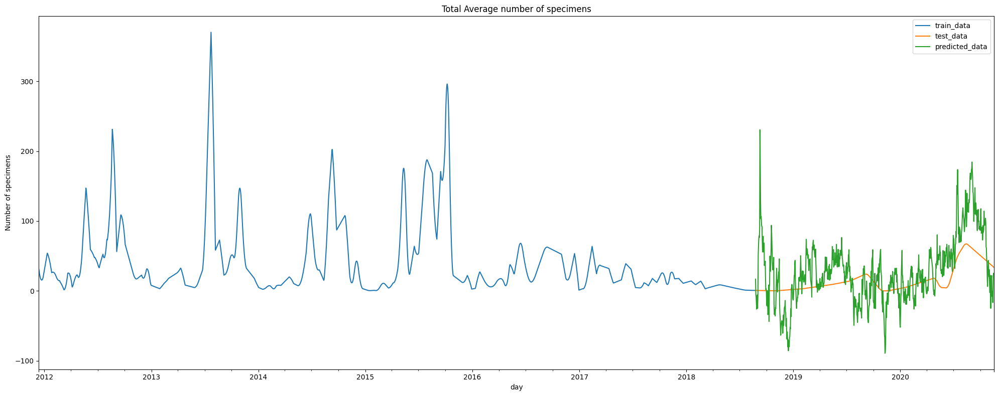

In [92]:
fig, ax = plt.subplots(1,1, figsize=(20,8))

y_train.plot(ax=ax, label="train_data")
y_test.plot(ax=ax, label="test_data")

pd.Series(ebm.predict(X_test), index=X_test.index).plot(ax=ax, label="predicted_data", title="Total Average number of specimens", ylabel="Number of specimens")

plt.legend()
plt.tight_layout()
plt.show()

In [93]:
for train_index, test_index in tss.split(X[X.index < "2016-01-01"]):
    X_train, X_test = X.iloc[train_index, :], X.iloc[test_index,:]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

In [94]:
ebm = ExplainableBoostingRegressor()
ebm.fit(X_train, y_train)

ExplainableBoostingRegressor()

In [95]:
mean_squared_error(y_test.values, ebm.predict(X_test))

3839.0083489726976

In [96]:
mean_absolute_error(y_test.values, ebm.predict(X_test))

40.94762866855484

In [97]:
show(ebm.explain_global())

In [98]:
print("Testing from {} to {}".format(y_test.index.min(), y_test.index.max()))

Testing from 2014-12-27 00:00:00 to 2015-12-31 00:00:00


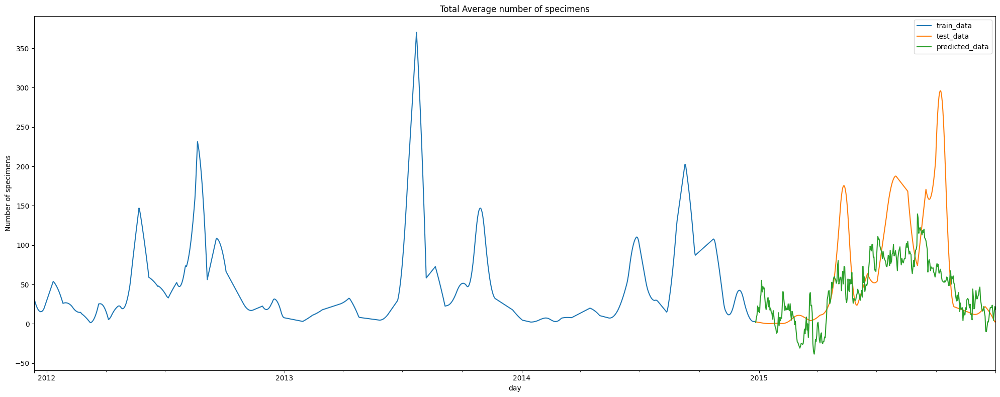

In [99]:
fig, ax = plt.subplots(1,1, figsize=(20,8))

y_train.plot(ax=ax, label="train_data")
y_test.plot(ax=ax, label="test_data")

pd.Series(ebm.predict(X_test), index=X_test.index).plot(ax=ax, label="predicted_data", title="Total Average number of specimens", ylabel="Number of specimens")

plt.legend()
plt.tight_layout()
plt.savefig("evo_prediction.png")
plt.show()

#### Evalutation of impacts

While the data is too sparse to allow the expression of the species population, we propose the following method to evaluate the impacts of protection measures for the AMPA area.

Below we plot the linear regression lines for the total average sessil species specimens in AMPA and F Zone for the period after 2018-01-01.

This could be easily adapted to focus in a single species or group of species, or to compare different zones or in diferent times.

Knowing when certain measures took place it could be used to evaluate the effective impact in the population of the species.

Regression Line Formula: y = 2.678036767821522e-16x + -403.4911062348114
Regression Line Formula: y = 5.087352016520447e-16x + -777.1724766666501


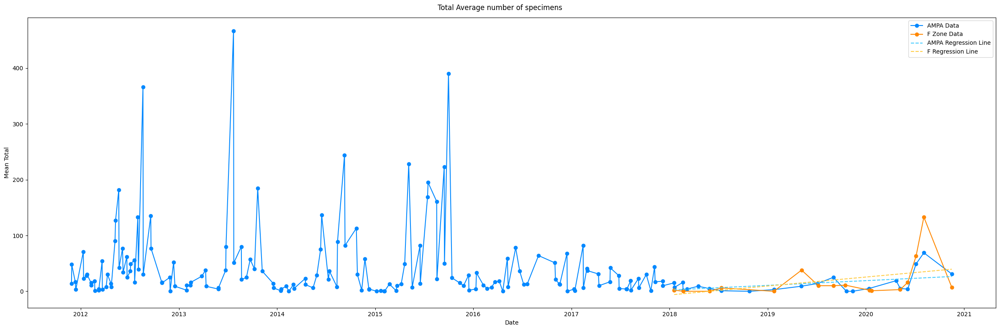

In [100]:
# Obtain a regression over the data above
from sklearn.linear_model import LinearRegression

# Daily mean
df_mobil_global_mean_AMPA = df_mobil[df_mobil["Zone"]!='F'].groupby(["Date"])[mobil_species_columns].sum()
df_mobil_global_mean_F = df_mobil[df_mobil["Zone"]=='F'].groupby(["Date"])[mobil_species_columns].sum()

# Calculate the regression after the interventions took place
# FIXTHIS - fix the date
df_mobil_global_mean_AMPA_after = df_mobil_global_mean_AMPA[df_mobil_global_mean_AMPA.index>"2018-01-01"].sum(axis=1)
df_mobil_global_mean_F_after = df_mobil_global_mean_F[df_mobil_global_mean_F.index>"2018-01-01"].sum(axis=1)

def get_regression_params(X, y):
    regression_model = LinearRegression()
    regression_model.fit(X, y)
    
    # Print the regression line formula
    slope = regression_model.coef_[0]
    intercept = regression_model.intercept_
    return regression_model, slope, intercept    

# Assuming you want to perform regression on the AMPA data after 2018-01-01:
X = df_mobil_global_mean_AMPA_after.index.astype(int).values.reshape(-1, 1)
y = df_mobil_global_mean_AMPA_after.values

regression_model_AMPA, slope, intercept = get_regression_params(X, y)

# Print the regression line formula
print(f"Regression Line Formula: y = {slope}x + {intercept}")

# Predict the values
predicted_values_AMPA = regression_model_AMPA.predict(X)

# We compare it with the F data after 2018-01-01:
X = df_mobil_global_mean_F_after.index.astype(int).values.reshape(-1, 1)
y = df_mobil_global_mean_F_after.values

regression_model_F, slope, intercept = get_regression_params(X, y)

# Print the regression line formula
print(f"Regression Line Formula: y = {slope}x + {intercept}")

# Predict the values
predicted_values_F = regression_model_F.predict(X)


plt.figure(figsize=(24, 8))
plt.plot(
    df_mobil_global_mean_AMPA.index,
    df_mobil_global_mean_AMPA.sum(axis=1).values,
    marker='o',
    color="#08F",
    label='AMPA Data'
)
plt.plot(
    df_mobil_global_mean_F.index,
    df_mobil_global_mean_F.sum(axis=1).values,
    marker='o',
    color="#F80",
    label='F Zone Data'
)
plt.plot(
    df_mobil_global_mean_AMPA_after.index,
    predicted_values_AMPA,
    color='#4CF',
    linestyle='--',
    label='AMPA Regression Line'
)
plt.plot(
    df_mobil_global_mean_F_after.index,
    predicted_values_F,
    color='#FC4',
    linestyle='--',
    label='F Regression Line'
)

plt.suptitle("Total Average number of specimens")

plt.xlabel('Date')
plt.ylabel('Mean Total')
plt.legend()
plt.tight_layout()
plt.savefig("evo_impact.png")
plt.show()

## 🖼️ Visualisations

### Explaining Species groups (Seabreams)

In [101]:
show(ebm_explain.explain_global())

### Infering the total number of specimens

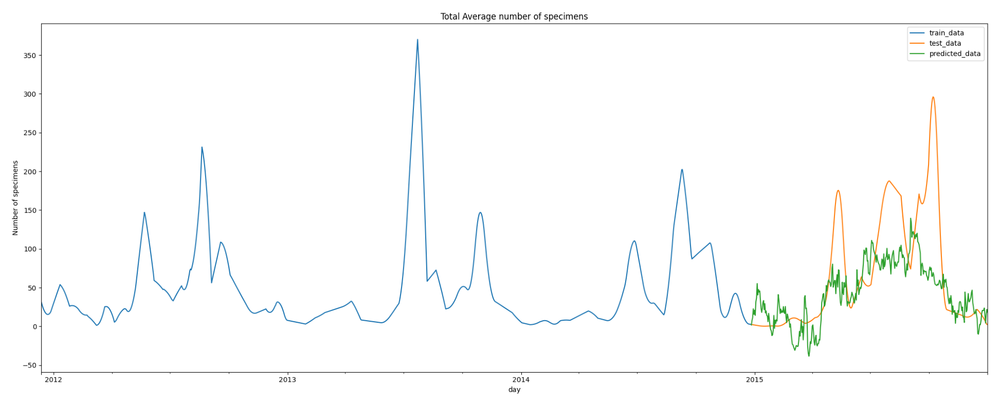

In [102]:
img = mpimg.imread("evo_prediction.png")
plt.figure(figsize=(20,8))
imgplot = plt.imshow(img)
plt.axis('off')
plt.tight_layout()
plt.show()

### Measuring and comparing impacts of changes in time

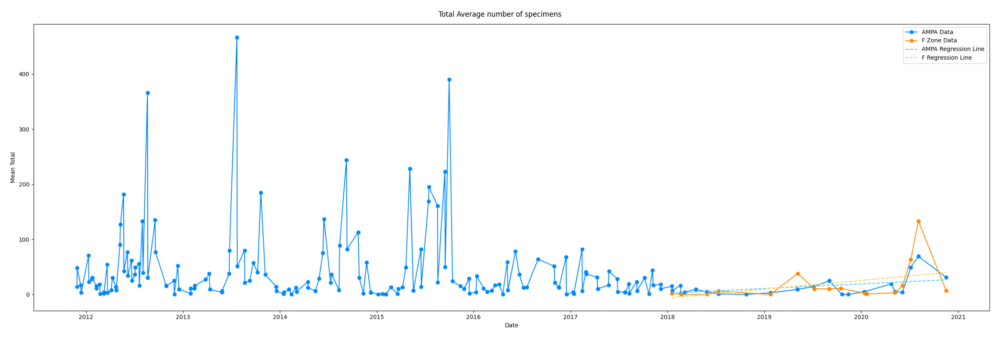

In [103]:
img = mpimg.imread("evo_impact.png")
plt.figure(figsize=(24,8))
imgplot = plt.imshow(img)
plt.axis('off')
plt.tight_layout()
plt.show()

## 👓 References

* Species references:
    * https://www.marinespecies.org/
    * https://www.marlin.ac.uk/species/detail/1933
    * https://genomics.senescence.info/species/index.html
    * https://www.inaturalist.org/projects/sea-slugs-of-portugal
    * http://macoi.ci.uc.pt/macoi_list.php
    * https://a-z-animals.com/animals/
* Dataset references:
    * https://www.ncei.noaa.gov/access/world-ocean-database/datawodgeo.html
    * https://ambiente.cascais.pt/pt/page/monitorizacao-biologica-da-amp-das-avencas
    * https://open-meteo.com/en/docs/historical-weather-api
    * https://data.cascais.pt/en/data-hub
    * https://www.ncei.noaa.gov/access/world-ocean-database/bin/getgeodata.pl?Depth=O&WorldOcean.x=743&WorldOcean.y=188 (Parser: https://www.ncei.noaa.gov/data/oceans/woa/WOD13/PROGRAMS/)
    * https://odv.awi.de/data/ocean/
    * https://www.eea.europa.eu/ims/ocean-acidification
    * https://www.uea.ac.uk/web/groups-and-centres/climatic-research-unit/data
* News and Social references:
    * https://www.rtp.pt/noticias/pais/poluicao-no-rio-tejo-o-que-ja-se-sabe_n1055778
    * https://blog.science4you.pt/curiosidades/poluicao-no-rio-tejo/
* Knownledge references:
    * https://www.surfertoday.com/windsurfing/how-to-read-wind-direction
    * https://interpret.ml/docs/ebm.html